# Vector Calculus

Classical electrodynamics describes electromagnetic fields that vary in time and space.  To describe these variations, we use the mathematical framework of ***vector calculus***.  This means that we take derivatives and integrals of scalar and vector fields in three dimensions.  This notebook will introduce you to the most important operations of vector calculus in electrodynamics and give you some tools for visualizing the effect of these operations.

## Modules

A **module** is a collection of Python functions defined in a separate file.  This notebook uses a couple of custom modules: `Electrodynamics.py` and `VectorCalculus.py`.

Before we import them, find these files in your directory, open them, and inspect their contents.

- What are some of the functions defined in these modules?  What do they do?

The functions in the Electrodynamics.pv module can generate a coordinate grid, find the potential and electric field of a point charge, and plot the vector field. 

VectorCalculus.py includes functions to calculate the gradient, divergence, and curl, as well as integrating over volumes, surfaces, and lines. 

In [2]:
# Get access to useful functions.
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d

# Get access to custom functions.
import VectorCalculus as vc
import Electrodynamics as ed

from importlib import reload
reload(vc)
reload(ed)

<module 'Electrodynamics' from '/Users/lucasmiller/Documents/OIT/PHY 330 Magnetism/electrodynamics/week-02/Electrodynamics.py'>

In [9]:
## Use this command to turn ON interactive plots:
# %matplotlib notebook

## Use this command to turn OFF interactive plots.
%matplotlib inline

Now that we have access to the functions, let's create an electric field, an electrostatic potential, and start exploring.

In [4]:
# Define coordinate grid.
num_points = 257
box_size = 5

# Store coordinate arrays.
X,Y,Z = ed.coordinates(L=box_size, N=num_points)

# Compute grid spacing.
ds = X[1,0,0] - X[0,0,0]

# Store grid and spacing in a single object for repeated use later.
grid = (X,Y,Z,ds)

# Define charge and location of two point charges.
Q1 = +1
x1 = -1
y1 = 0
z1 = 0
R1 = np.array([x1,y1,z1])

Q2 = -1
x2 = +1
y2 = 0
z2 = 0
R2 = np.array([x2,y2,z2])

# Compute the potential.
V  = ed.point_charge_potential(Q1, R1, X, Y, Z)
V += ed.point_charge_potential(Q2, R2, X, Y, Z)

# Compute the electric field.
E  = ed.point_charge_field(Q1, R1, X, Y, Z)
E += ed.point_charge_field(Q2, R2, X, Y, Z)

<Axes3DSubplot:>

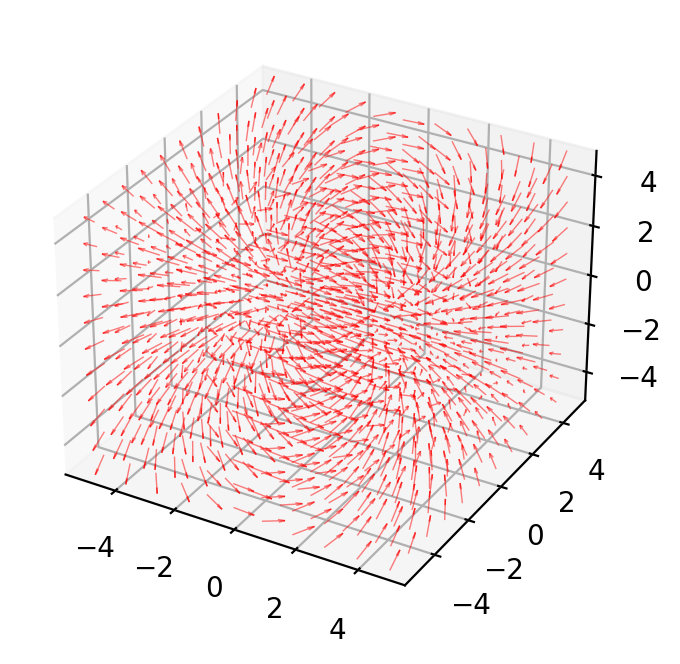

In [10]:
# Draw the electric field.
ed.draw_vector_field(X,Y,Z,*E)

<AxesSubplot:>

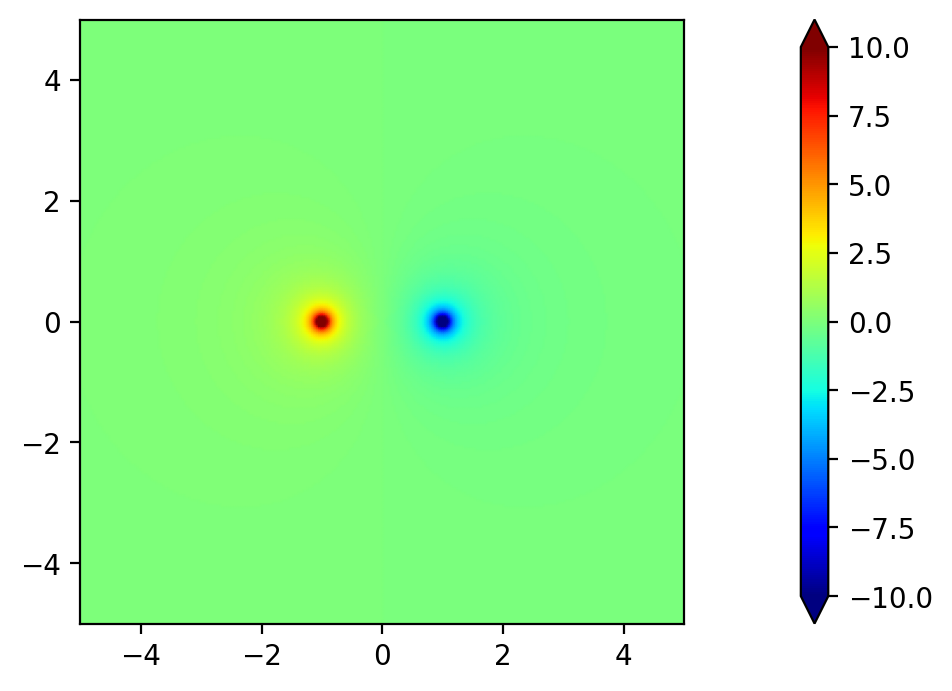

In [11]:
# Draw a slice through the potential.
z0 = 0.0
ed.draw_scalar_field(X,Y,Z,V,z0, cutoff=10)

## Integrals

When you first learned what an integral was, you probably learned about a one dimensional integral of a function of just one variable: $\int dx \, f(x)$.  In electrodynamics, we have three dimensions, so all of our functions have three variables: $V(x,y,z)$, $\vec{E}(x,y,z)$.  What's more, some of the fields we work with are vector fields, so they have three components.  We can integrate these fields over lines, surfaces, or volumes.

Let's look at some of the useful integrals we can create.

## Line Integral

A familiar operation from vector calculus is the line integral.  We use it in classical mechanics to calculate the work required to move a system from point A to point B:

$$W = \int_{A}^{B} d\vec{s} \cdot \vec{F}$$

We can generalize the idea of the line integral to any vector field.  Let's explore this concept for the electric field of two charges.

The contour integral is 0.03640960765393995


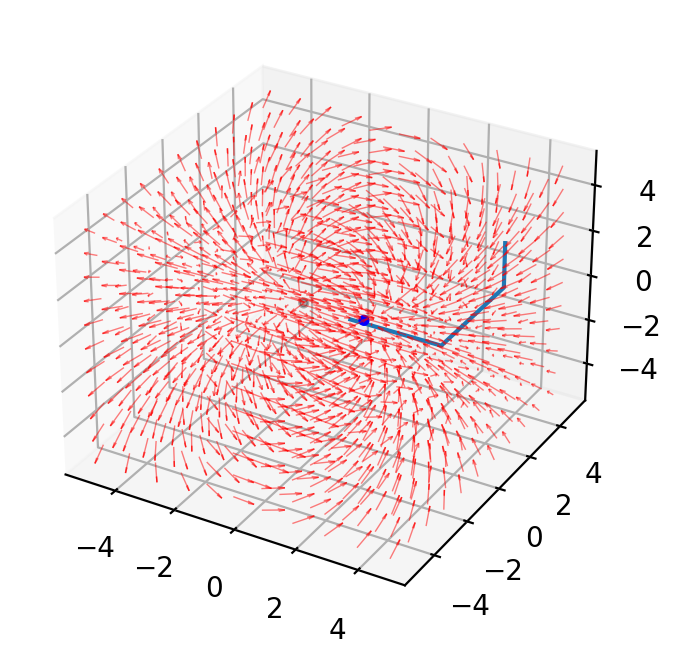

In [27]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 3 * vc.eX
dy = 4 * vc.eY
dz = 2 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

The contour integral is 0.059634457600070835


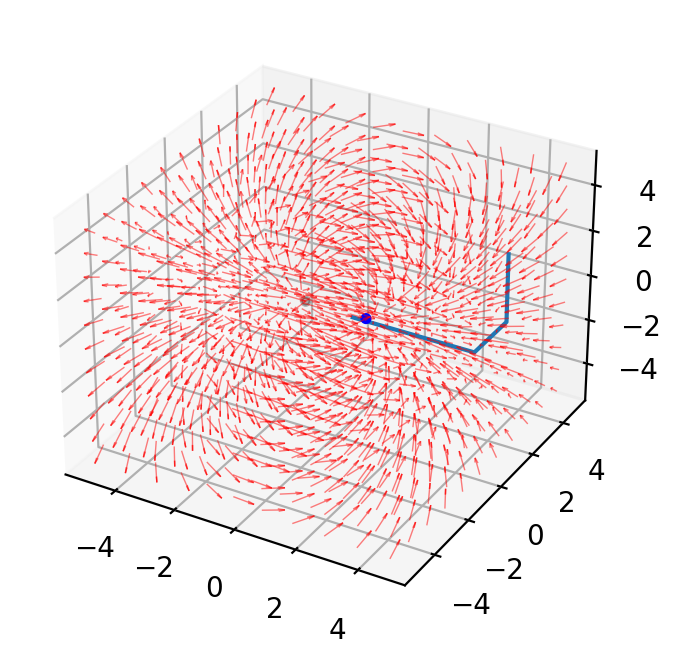

In [29]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 4 * vc.eX
dy = 2 * vc.eY
dz = 3 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

The contour integral is 0.02680555140504439


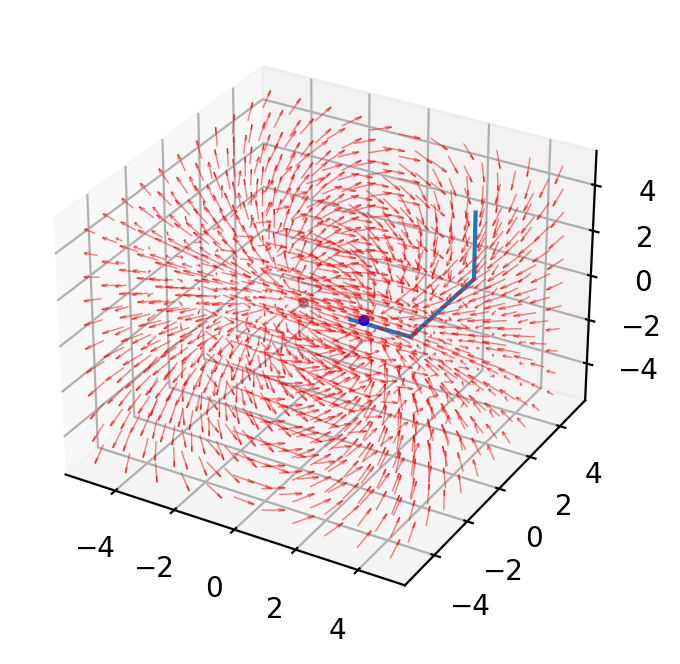

In [30]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 2 * vc.eX
dy = 4 * vc.eY
dz = 3 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

The contour integral is 0.05048586595930066


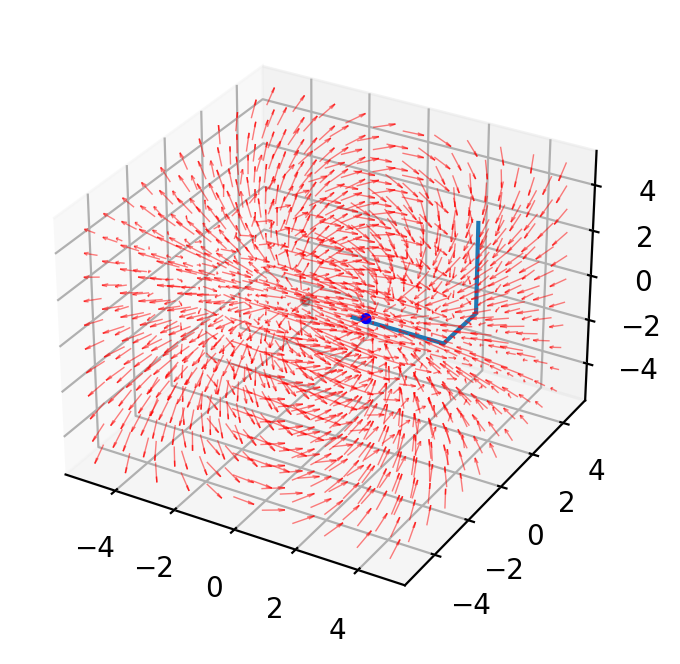

In [32]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 3 * vc.eX
dy = 2 * vc.eY
dz = 4 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

The contour integral is 0.050317162533756836


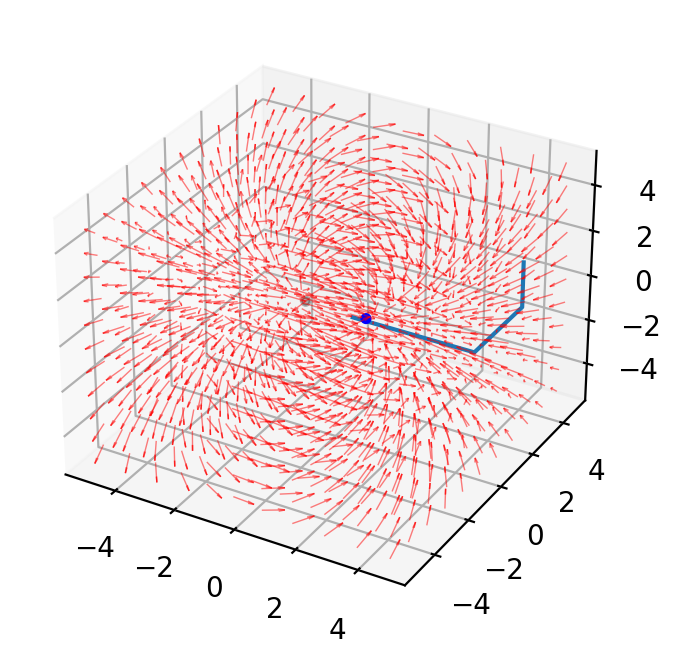

In [33]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 4 * vc.eX
dy = 3 * vc.eY
dz = 2 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

The contour integral is 0.03148999068529405


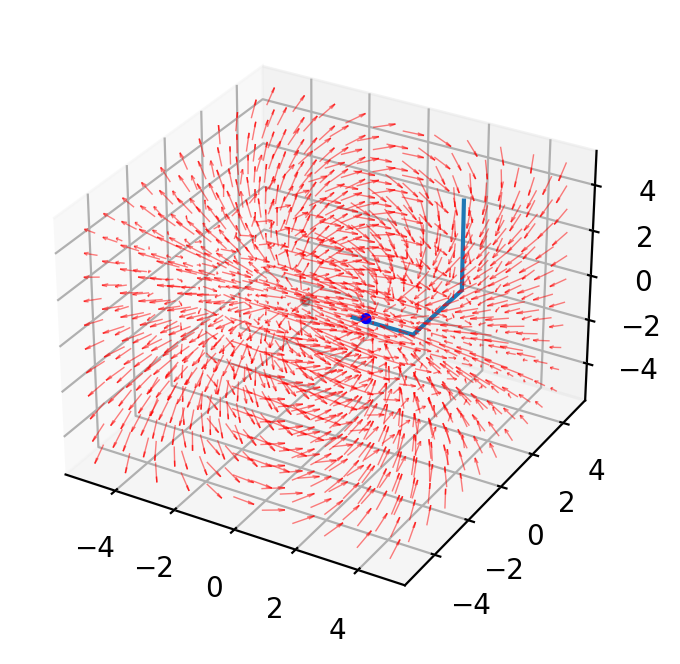

In [35]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 2 * vc.eX
dy = 3 * vc.eY
dz = 4 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

By changing the order of the steps (dx, dy, dz) you can generate six different paths between the starting and ending point.  Do this.  What range of values do you observe for the different paths?

Values range from as low as 0.0268 to as high as 0.0505. 

Create a path with at least 6 points.  Plot it here.

The contour integral is 0.03553069517654853


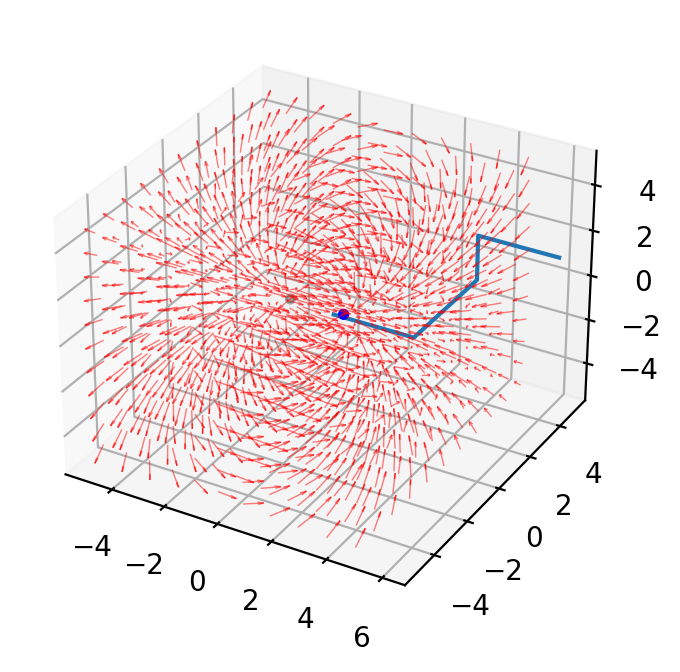

In [50]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 3 * vc.eX
dy = 4 * vc.eY
dz = 2 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz
P4 = P3 + dx
P5 = P4 + dy
P6 = P5 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

In [ ]:
# Define a path.
x0 = 0
y0 = 1
z0 = -1

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 3 * vc.eX
dy = 4 * vc.eY
dz = 2 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dy
P3 = P2 + dz
P4 = P3 + dx
P5 = P4 + dy
P6 = P5 + dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4, P5]

# Compute the contour integral.
W = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The contour integral is", W)

I am able to add P4, but as soon as I try to add P5 or P6 to the list of points, I get an error message saying "can only do surfaces parallel to xy, xz, or yz planes." I'm leaving both versions of the code in here for reference. 

## Circulation

If the contour for a line integral starts and ends on the same point, its value is called the **circulation** of the vector field, sometimes given the symbol $\Gamma$:

$$\Gamma = \oint d\vec{s} \cdot \vec{E}$$

The "O" on the integral sign is to indicate that the path is actually a closed loop.

The circulation integral is 0.0015785810219010044


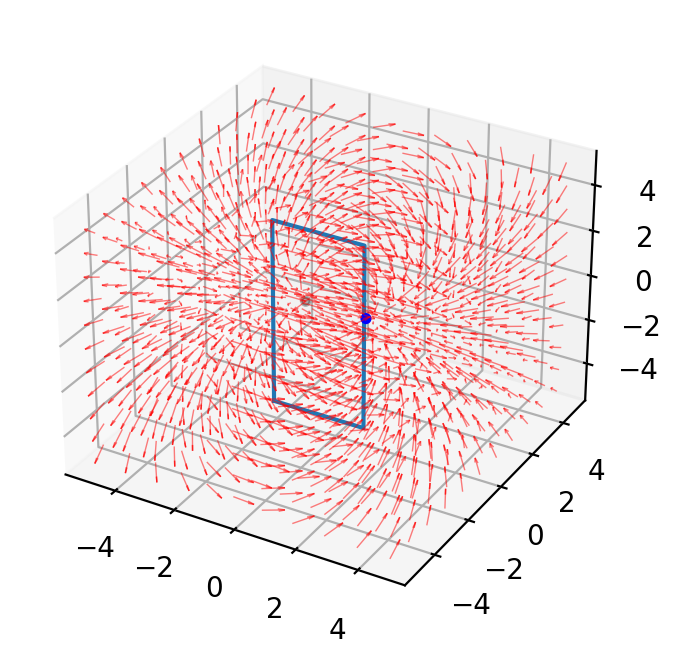

In [51]:
# Define a path.
x0 = -1.5
y0 = -1
z0 = -4

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 3 * vc.eX
dy = 4 * vc.eY
dz = 8 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dz
P3 = P2 - dx
P4 = P3 - dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the circulation.
Gamma = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The circulation integral is", Gamma)

The circulation integral is -0.0038257501807925642


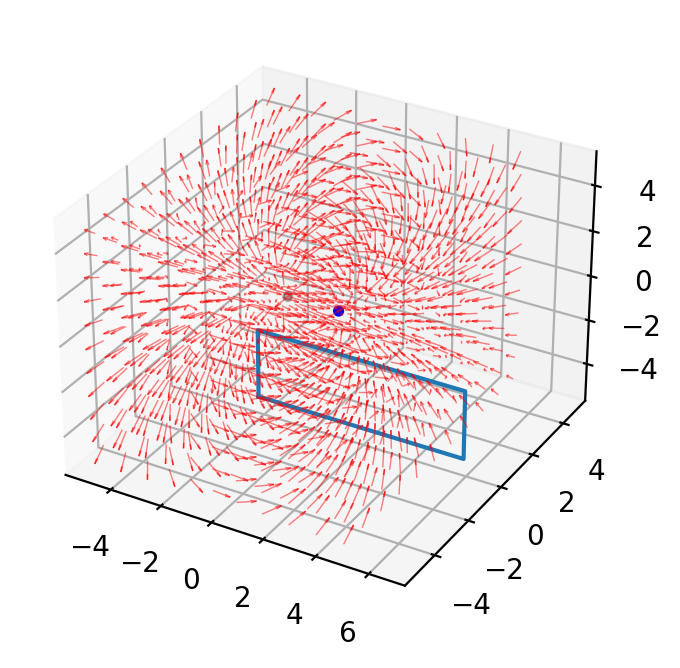

In [52]:
# Define a path.
x0 = -1.5
y0 = -1
z0 = -4

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 8 * vc.eX
dy = 4 * vc.eY
dz = 3 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dz
P3 = P2 - dx
P4 = P3 - dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the circulation.
Gamma = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The circulation integral is", Gamma)

The circulation integral is 0.0007169011975336481


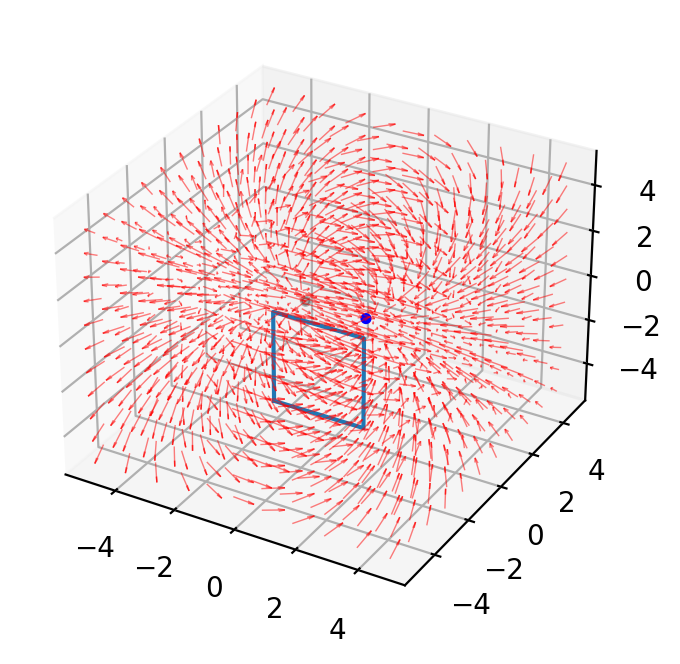

In [53]:
# Define a path.
x0 = -1.5
y0 = -1
z0 = -4

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 3 * vc.eX
dy = 8 * vc.eY
dz = 4 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dz
P3 = P2 - dx
P4 = P3 - dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the circulation.
Gamma = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The circulation integral is", Gamma)

The circulation integral is -0.0024419286436716814


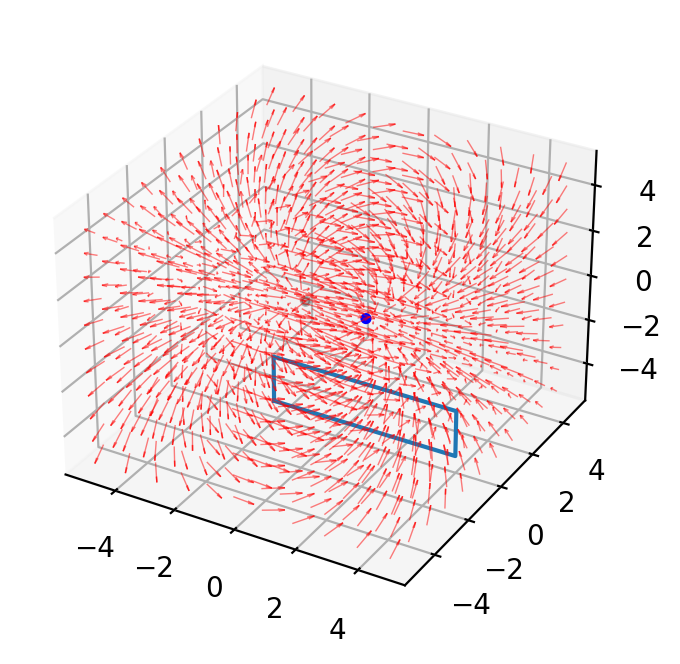

In [55]:
# Define a path.
x0 = -1.5
y0 = -1
z0 = -4

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 6 * vc.eX
dy = 10 * vc.eY
dz = 2 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dz
P3 = P2 - dx
P4 = P3 - dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the circulation.
Gamma = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The circulation integral is", Gamma)

The circulation integral is -0.0007740496544635656


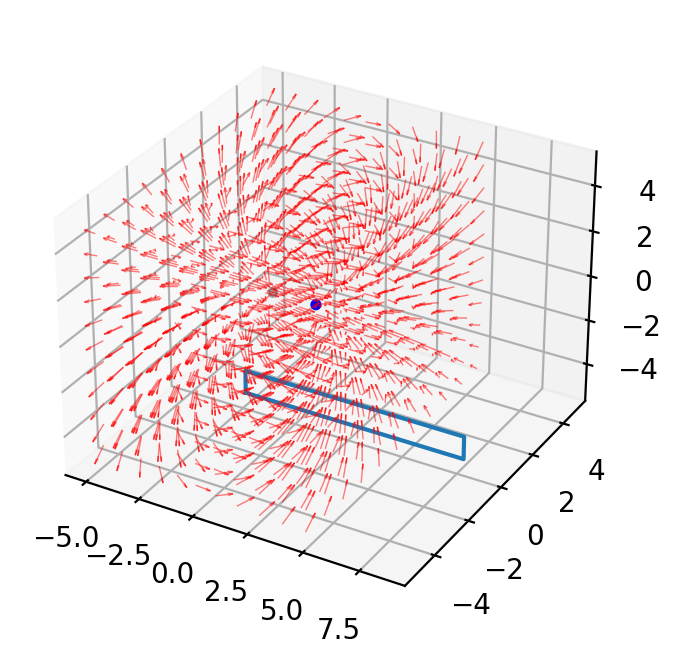

In [61]:
# Define a path.
x0 = -1.5
y0 = -1
z0 = -4

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 10 * vc.eX
dy = 1 * vc.eY
dz = 1 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dz
P3 = P2 - dx
P4 = P3 - dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the circulation.
Gamma = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The circulation integral is", Gamma)

The circulation integral is 0.0002288341007346175


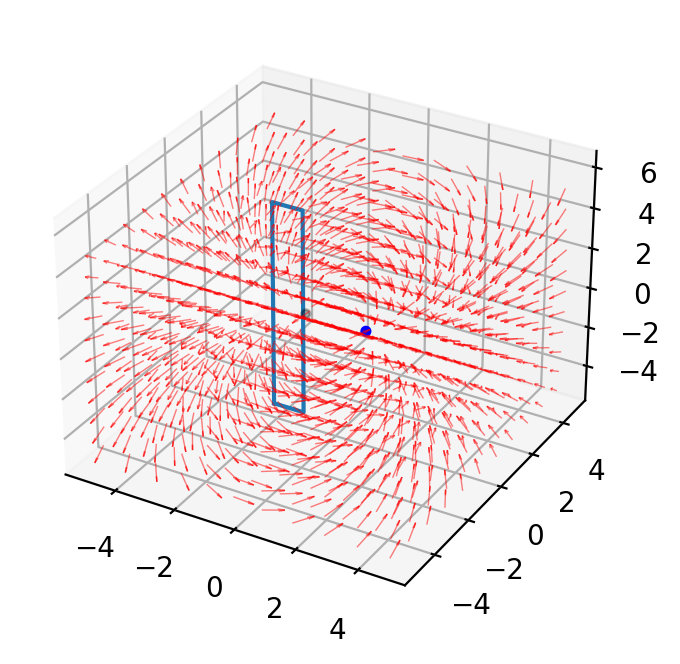

In [59]:
# Define a path.
x0 = -1.5
y0 = -1
z0 = -4

# Initial position.
P0 = np.array([x0,y0,z0])

# Use unit vectors to define the displacement.
dx = 1 * vc.eX
dy = 1 * vc.eY
dz = 10 * vc.eZ

# Move to endpoint in steps along a single axis.
P1 = P0 + dx
P2 = P1 + dz
P3 = P2 - dx
P4 = P3 - dz

# Assemble the points into a list.
points = [P0, P1, P2, P3, P4]

# Compute the circulation.
Gamma = vc.path_integral(E, points, *grid)

# Draw the electric field and the path.
ax = vc.draw_path(E, points, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The circulation integral is", Gamma)

Move the loop around and change its size and orientation by modifying the code above.  You can try adding more points if you would like.

Compute the circulation for at least 6 different contours.  What range of values do you observe?

Values are quite low across the board, and range from -0.0038 to +0.0015. Adjusting the dx, dy, and dz values appears to change the shape of the "circular" path. The dx value stretches the shape horizontally and dy stretches it vertically (according to our current frame of reference). 

## Flux

A **flux** is often defined as an amount of *something* passing through a surface per unit time: energy, charge, mass, volume of fluid, etc.  However, the mathematical concept is more general.  We can compute the flux of *any* vector field through *any* surface.  The resulting quantity is often given the symbol $\Phi$.

$$\Phi = \int d\vec{A} \cdot \vec{E}$$

$d\vec{A}$ is an **area element** whose direction is perpendicular to the surface.  When the surface is closed, we indicate this with a modified integral sign.

$$\Phi = \oint d\vec{A} \cdot \vec{E}$$

Gauss' law is an example of flux through a closed surface.

The flux through the box is -12.522524191566792


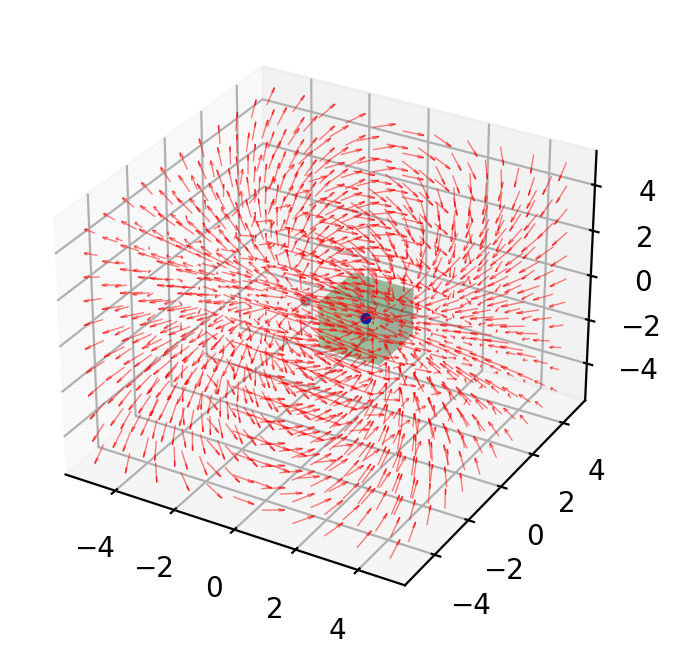

In [75]:
# Define rectangular box for computing flux.
# Coordinates of center.
xC = 1
yC = 0
zC = 0

# Lenth of sides.
dX = 2
dY = 2
dZ = 2

# Bottom, front, left corner, required by flux and plotting functions.
P0 = np.array([xC, yC, zC]) - np.array([dX,dY,dZ]) / 2

# Compute the flux.
Phi = vc.flux(E, P0, dX, dY, dZ, *grid)

# Draw the box and the field.
ax = vc.draw_box(E, P0, dX, dY, dZ, *grid)

# Indicate location of charges in plot.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Display the result.
print("The flux through the box is", Phi)

Explore the flux of this electric field.  Move the box around and change its shape by modifying the code above.

What range of values do you observe when ***no charges are in the box***?

The values are quite low when no charges are in the box - on the order of roughly +/-0.002. This makes sense. As the box moves farther from the point charges, the flux should decrease. 

What range of values do you observe when ***only one charge is in the box***?

Flux increases greatly with just one charge in the box. This makes sense, too, as the presence of a single point charge within a volume should result in all field lines either coming into or moving out of the shape. 

What range of values do you observe when ***both charges are in the box***?

Values are low again when both charges are present. This also makes sense, as the charges are +1 and -1, respectively, and thus cancel each other out to some extent when sharing the same volume. 

## Derivatives

When you first learned about derivatives, as with integrals, you probably learned about the rate of change of a scalar function of a single variable: $\dfrac{df}{dx}$.

In mechanics, we also use derivatives of vector funcations: $\vec{v}(t) = \dfrac{d\vec{r}}{dt}$.

There are more possibilities for derivatives in three dimensions, especially when working with vector fields.  We will see three kinds of derivatives quite often in this course.

## Gradient

You may already be familiar with the gradient from an earlier physics course.  We can't simply "take the deriviative of a function" in three dimensions.  We need to specify a direction first.  The gradient is special, because it gives the direction of **steepest ascent** — the direction in which a function changes most rapidly at a particular point in space.  (If the function happens to give the height as a function of position, then the gradient points directly uphill.)

The gradient of a scalar function is defined as a collection of derivatives:
$$
\mathbf{grad}(f) = \nabla f = \dfrac{\partial f}{\partial x} \, \mathbf{e}_x
        + \dfrac{\partial f}{\partial y} \, \mathbf{e}_y
        + \dfrac{\partial f}{\partial z} \, \mathbf{e}_z
$$

In [76]:
# Define a function in 3D.
f = np.exp(-X**2 - Y**2 - Z**2)

# Compute its gradient.
df = vc.grad(f,ds)

<Axes3DSubplot:>

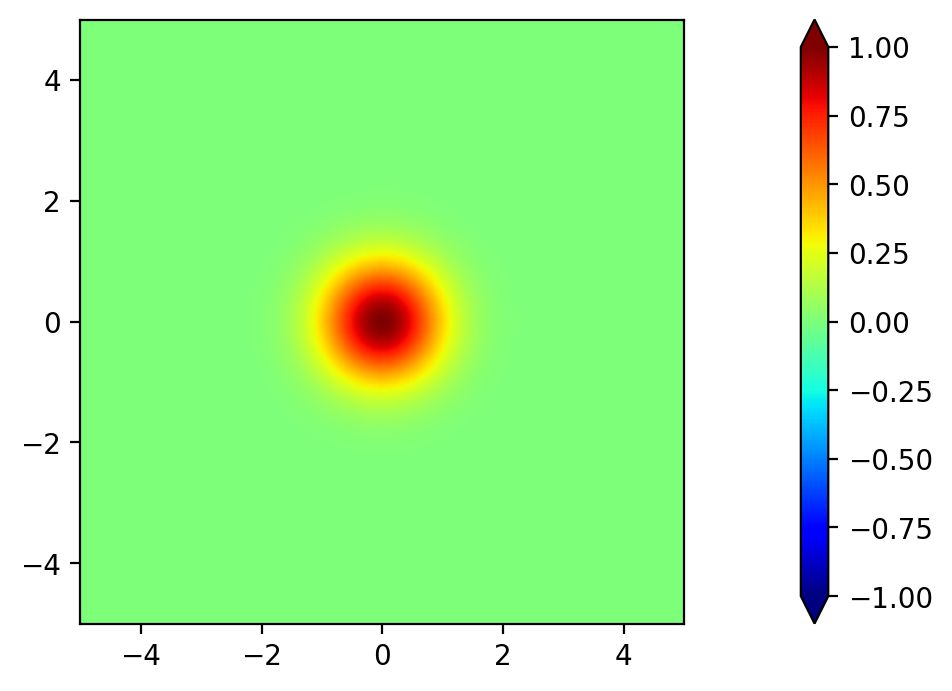

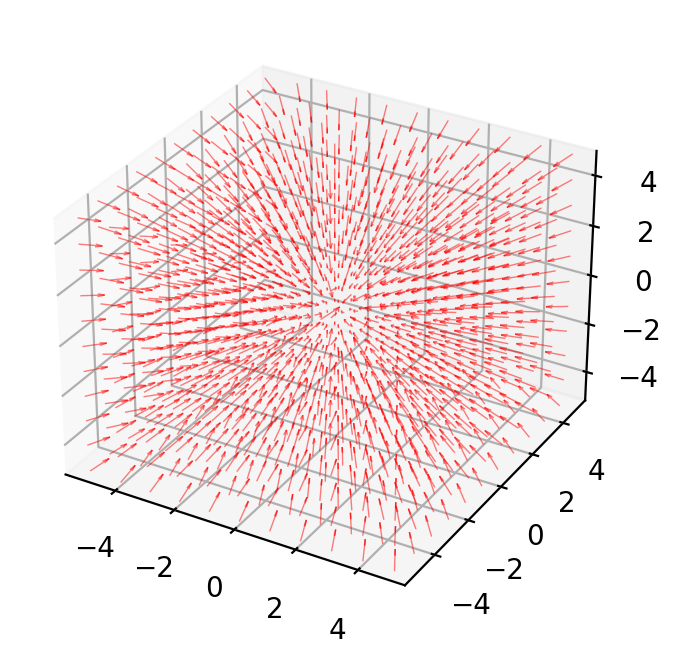

In [77]:
# Draw a slice of the function.
ed.draw_scalar_field(X,Y,Z,f, cutoff=f.max())

# Draw the resulting vector field.
ed.draw_vector_field(X,Y,Z,*df)

Compare the vector field to the scalar field.  Do the arrows make sense as a direction of steepest ascent?  Explain why or why not.

Yes, the two plots seem to be in alignment. All the vector arrows point toward the origin, implying the presence of a negative point charge in this precise location. The scalar field "slice" illustrates the same concept in a 2D format by showing that the steepest rise in potential occurs at the location of the point charge and gets less pronounced as you move radially away from the point. 

Change the definition of $f(x,y,z)$ to plot some other functions of your choosing.  Maybe try for something with ripples ...

What are your observations about the relation of the gradient to the starting function?

In [84]:
# Define a function in 3D.
f = X**3-Y**2+Z

# Compute its gradient.
df = vc.grad(f,ds)

<Axes3DSubplot:>

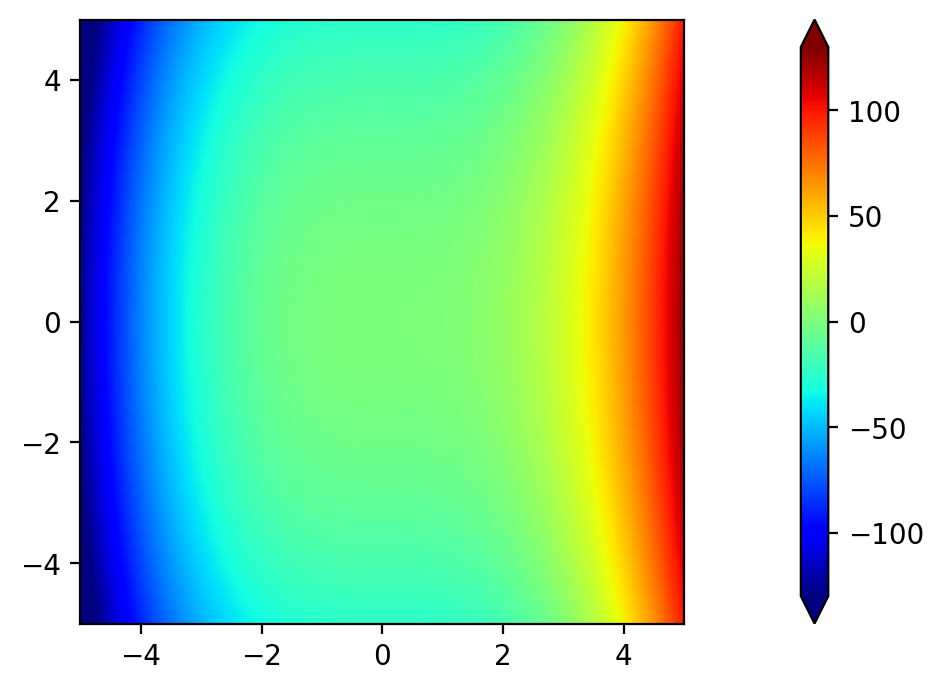

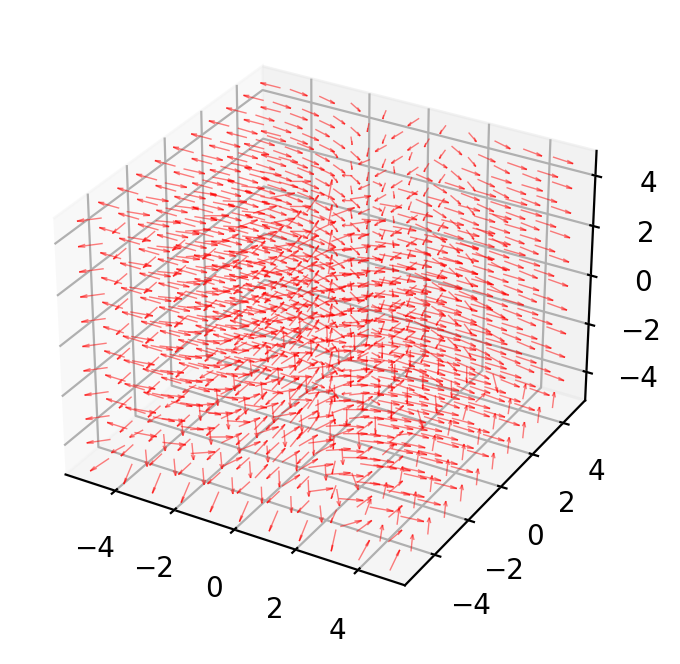

In [85]:
# Draw a slice of the function.
ed.draw_scalar_field(X,Y,Z,f, cutoff=f.max())

# Draw the resulting vector field.
ed.draw_vector_field(X,Y,Z,*df)

I played around with functions until I landed on one that left a satisfying gradient that matches the aesthetics of what comes to mind when you visualize a "gradient." The function drops rapidly in one direction and rises steeply in the other direction, with a period of slower ascent in-between. 

**Note:** Notice that the gradient maps a scalar field to a vector field.  It is possible to take the gradient of a vector field, but the resulting object is called a ***tensor***.  In three dimensions, it has 9 components and can be interpreted as a kind of ***matrix-valued function*** at every point in space.  These are difficult to plot!

When we take the derivative of a vector field $\vec{F}(x,y,z)$, there are 9 possible derivatives:
$$
\dfrac{\partial F_x}{\partial x},
\dfrac{\partial F_x}{\partial y},
\dfrac{\partial F_x}{\partial z},
\dfrac{\partial F_y}{\partial x},
\dfrac{\partial F_y}{\partial y},
\dfrac{\partial F_y}{\partial z},
\dfrac{\partial F_z}{\partial x},
\dfrac{\partial F_z}{\partial y},
\dfrac{\partial F_z}{\partial z},
$$

It turns out that two combinations of these derivatives are all that is required for electrodynamics!  One combination, called the **divergence** produces a scalar field.  The other, called the **curl** produces another vector field.

## Divergence

The divergence of a vector field $\vec{F}(x,y,z)$ is defined as
$$\mathbf{div}(\vec{F}) = \nabla \cdot \vec{F} = 
\dfrac{\partial F_x}{\partial x} + 
\dfrac{\partial F_y}{\partial y} +
\dfrac{\partial F_z}{\partial z}
$$

In [88]:
## Use this command to turn ON interactive plots:
%matplotlib notebook

## Use this command to turn OFF interactive plots.
# %matplotlib inline

In [89]:
# Define a vector field.
Fx = X**2 * Y
Fy = X*Y*Z**2
Fz = X*2 + Y*2
F = np.stack([Fx, Fy, Fz])

# Compute the divergence.
dF = vc.div(F,ds)

<IPython.core.display.Javascript object>


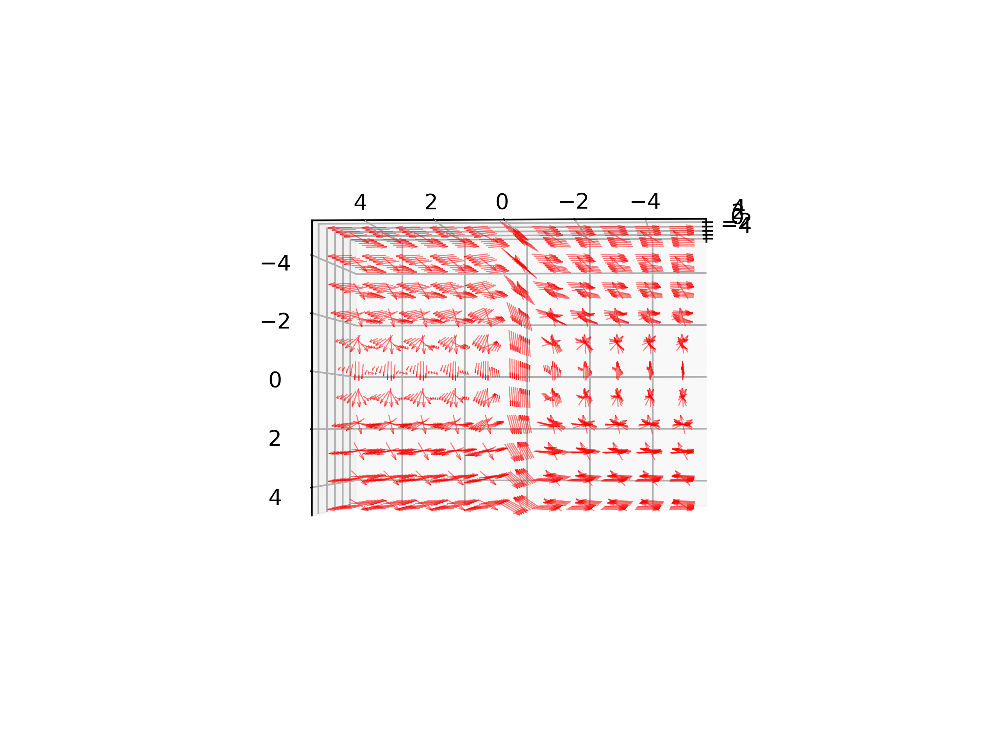

<IPython.core.display.Javascript object>


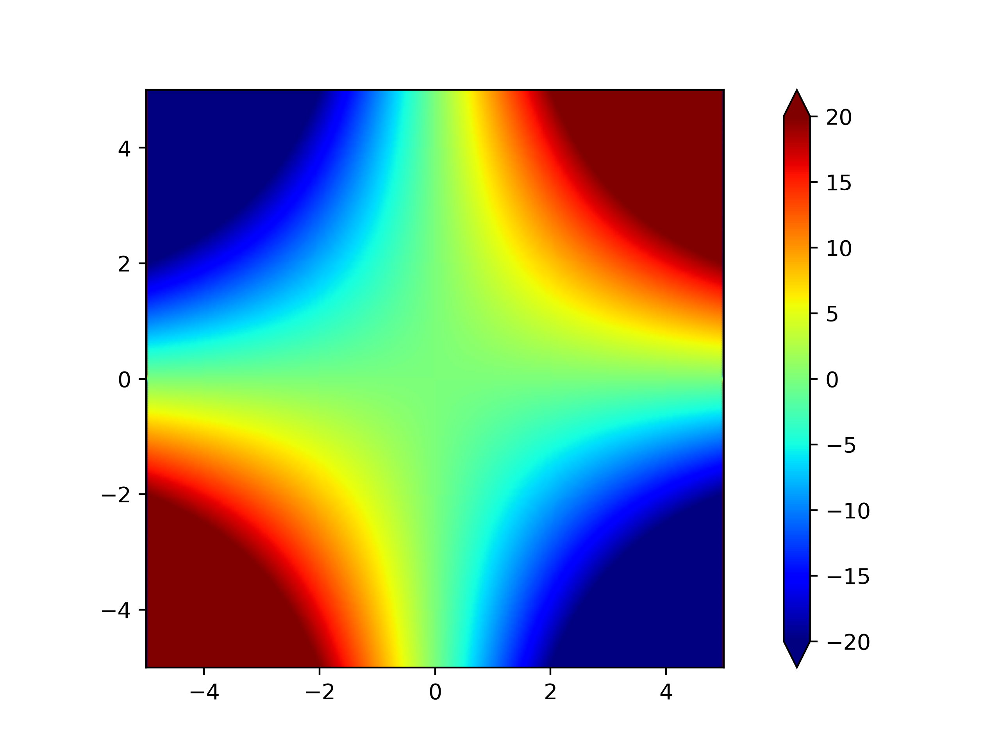

<AxesSubplot:>

In [90]:
# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot the divergence.
z0 = 0.0
ed.draw_scalar_field(X,Y,Z,dF,z0)

Compare the vector field to the scalar field.  Can you identify any correlations between the scalar field and the vector field?

The scalar field is much more intuitive to evaluate, especially as the number of field lines in the vector field increases. I updated the plot settings to make them interactive so I could drag/rotate the vector field. With careful manipulation, it is possible to match the field lines in the vector field to the "hot" or "cold" sections of the scalar field. 

Try looking at different slices of the divergence.  Try changing the definition of the vector field.  Describe your efforts and observations.

In [95]:
# Define a vector field.
Fx = X**3 * Y**2
Fy = X*Y*Z**2
Fz = X*2 + Y**2
F = np.stack([Fx, Fy, Fz])

# Compute the divergence.
dF = vc.div(F,ds)

<IPython.core.display.Javascript object>


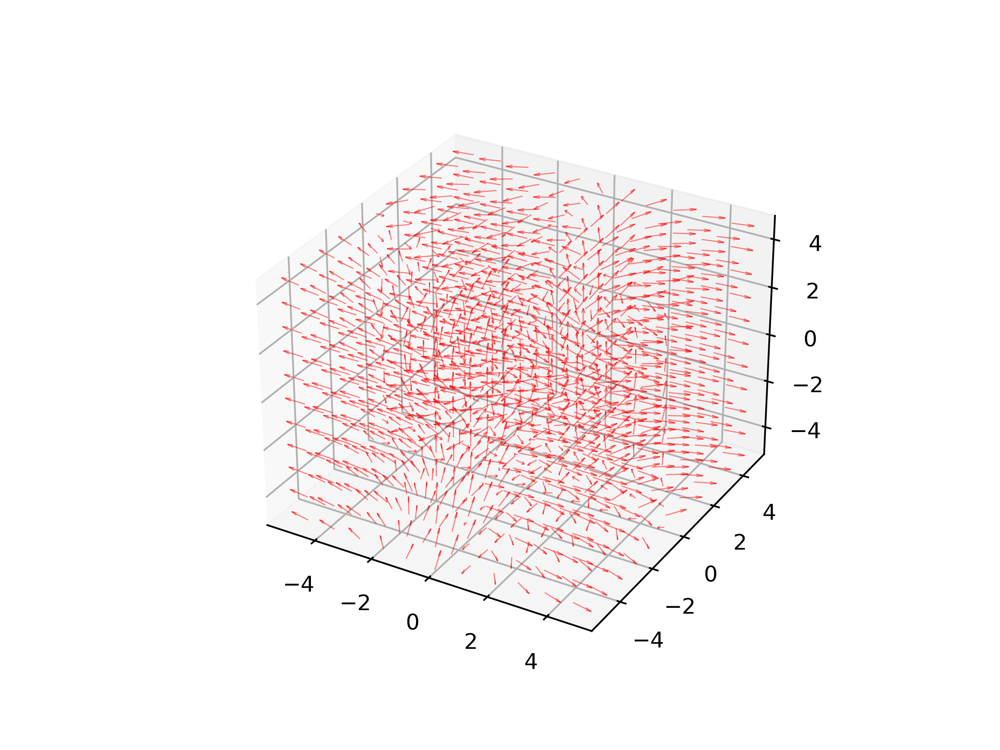

<IPython.core.display.Javascript object>


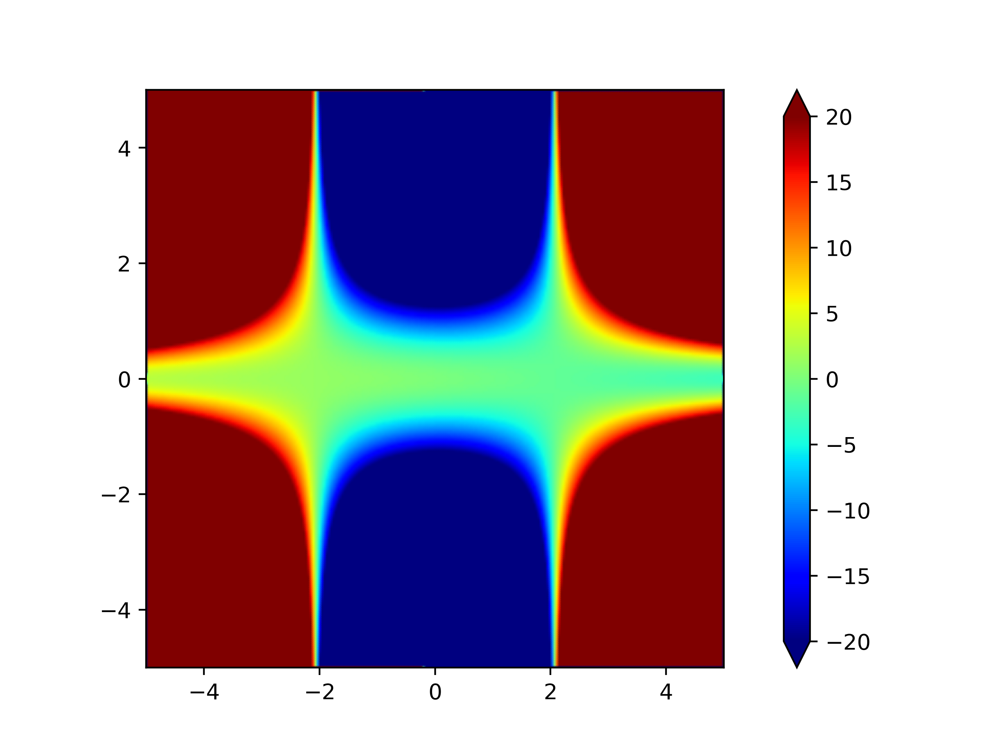

<AxesSubplot:>

In [98]:
# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot the divergence.
z0 = 5
ed.draw_scalar_field(X,Y,Z,dF,z0)

<IPython.core.display.Javascript object>


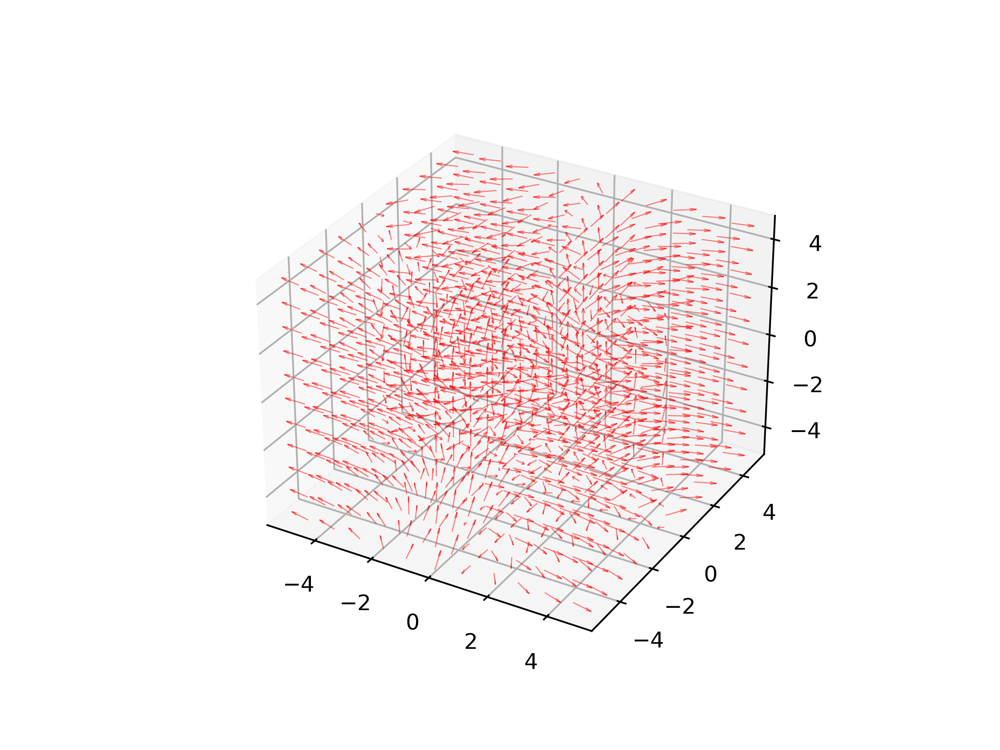

<IPython.core.display.Javascript object>


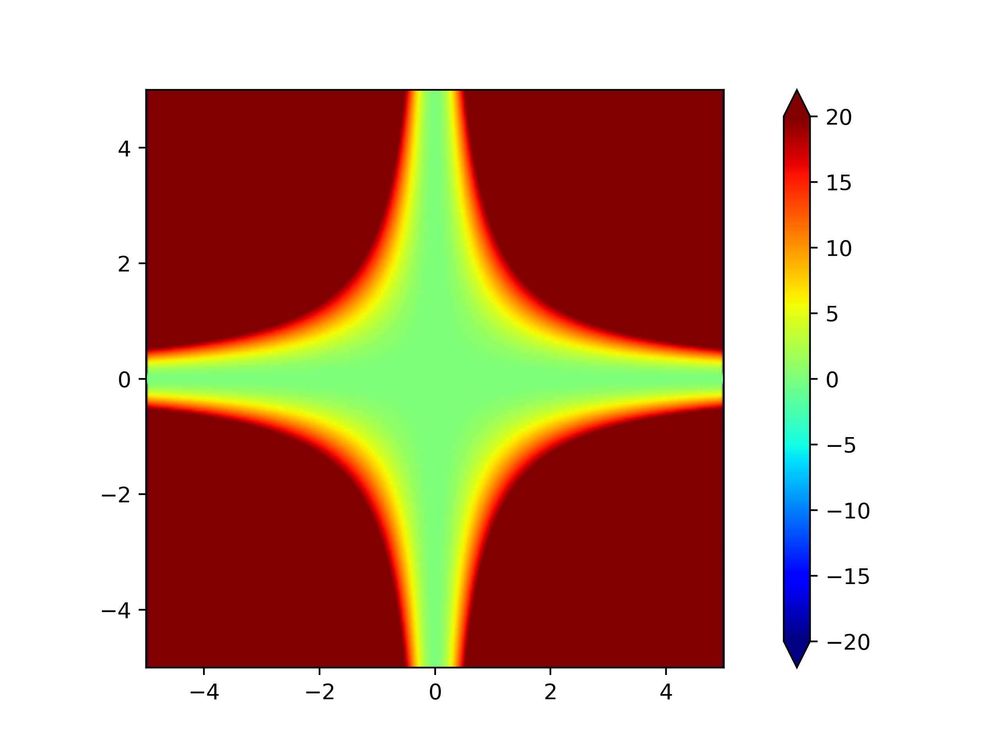

<AxesSubplot:>

In [99]:
# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot the divergence.
z0 = 0
ed.draw_scalar_field(X,Y,Z,dF,z0)

Adjusting the values of Fx, Fy, and Fz changes the shape of the 3D vector field overall. Adjusting the value of z0 changes the "height" of the xy-plane slice. The limits of z0 will coincide with those of the Fx, Fy, and Fz functions - i.e., z0 values can exceed the highest z value of the functions, which will yield a slice with no heatmap. Note the significant difference in the appearance of the scalar field when the slice is taken from z0=5 (top plot) and z0=0 (bottom plot).

According to Maxwell's equations, the divergence of the electric field is related to the charge density ...

In [100]:
# Compute the divergence of the electric field.
dE = vc.div(E,ds)

<IPython.core.display.Javascript object>


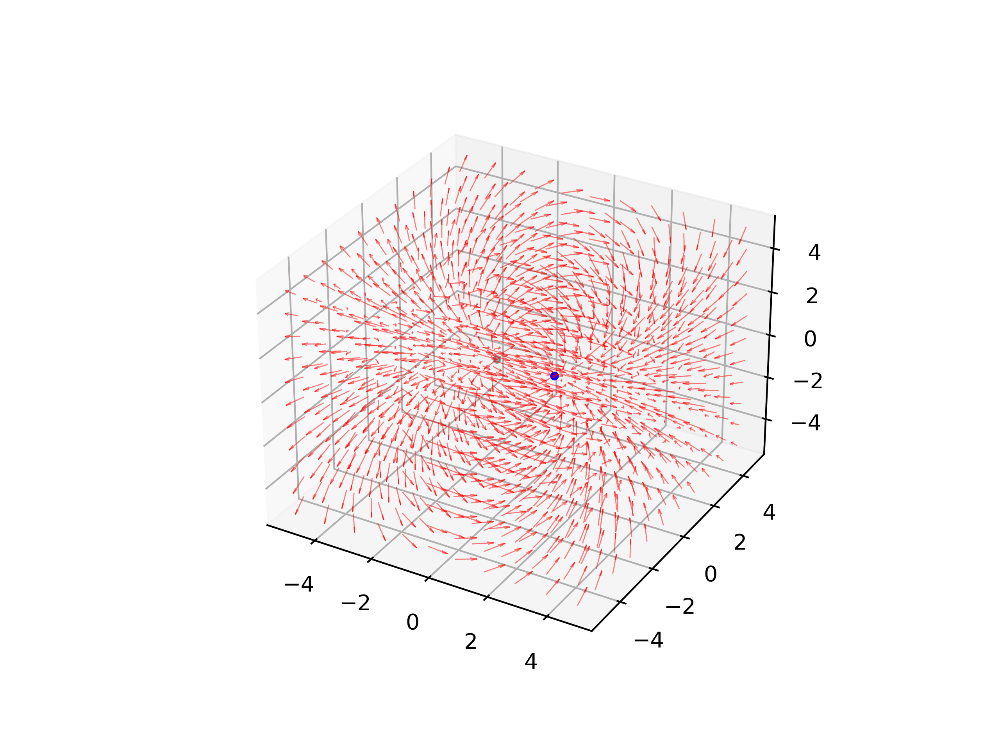

<IPython.core.display.Javascript object>


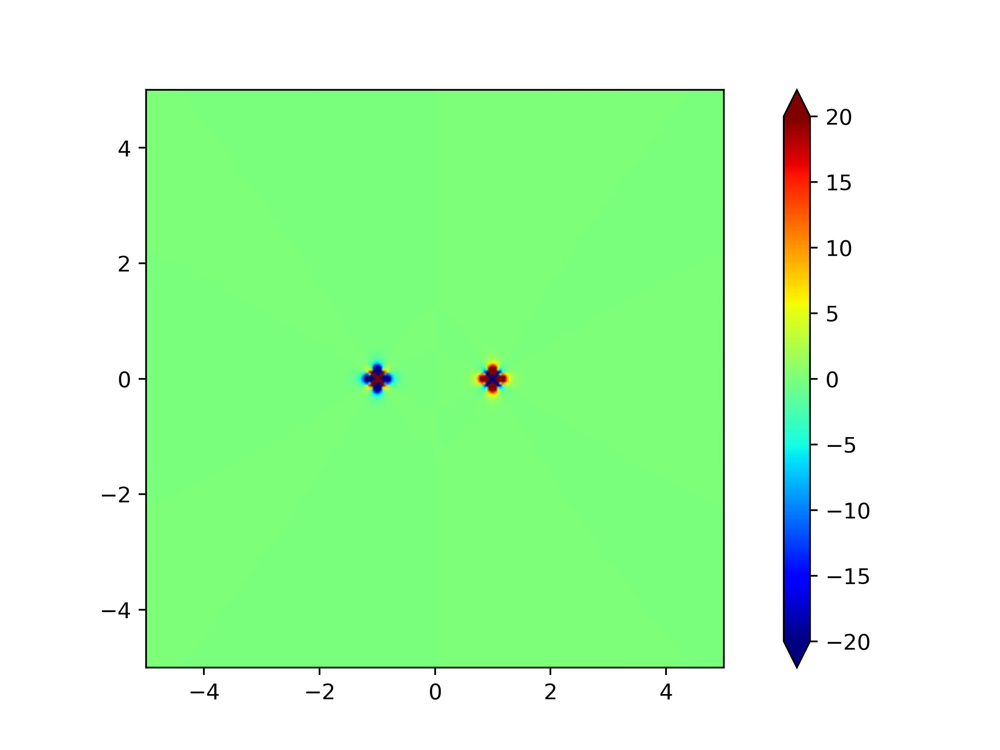

<AxesSubplot:>

In [101]:
# Plot the vector field ...
ax = ed.draw_vector_field(X,Y,Z,*E)

# ... with charges.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Plot the divergence.
ed.draw_scalar_field(X,Y,Z,dE)

What kind of correlation do you see between the electric field and its divergence?

Divergence appears to be at its highest in the immediate vicinity of the point charge, and it zero elsewhere. This makes sense, because divergence is a measure of the NET flow of flux around a point. Potential is either emitted by a positive charge or attracted to a negative charge (poor wording but you get the idea). This means that the small area surrounding each point charge will have a non-zero divergence if the number of field lines entering the area is different than the number leaving the area. For a positive point charge, for example, all field lines would be emitted from that point, meaning divergence is very high. For a random point far from both point charges, the field lines follow a circular path wherein the same number of field lines enter the space as leave it. 

In [111]:
# Define coordinate grid.
num_points = 257
box_size = 5

# Store coordinate arrays.
X,Y,Z = ed.coordinates(L=box_size, N=num_points)

# Compute grid spacing.
ds = X[1,0,0] - X[0,0,0]

# Store grid and spacing in a single object for repeated use later.
grid = (X,Y,Z,ds)

# Define charge and location of two point charges.
Q1 = +4
x1 = -1
y1 = -4
z1 = 0
R1 = np.array([x1,y1,z1])

Q2 = +1
x2 = +1
y2 = 0
z2 = 0
R2 = np.array([x2,y2,z2])

# Compute the potential.
V  = ed.point_charge_potential(Q1, R1, X, Y, Z)
V += ed.point_charge_potential(Q2, R2, X, Y, Z)

# Compute the electric field.
E  = ed.point_charge_field(Q1, R1, X, Y, Z)
E += ed.point_charge_field(Q2, R2, X, Y, Z)

In [112]:
# Compute the divergence of the electric field.
dE = vc.div(E,ds)

<IPython.core.display.Javascript object>


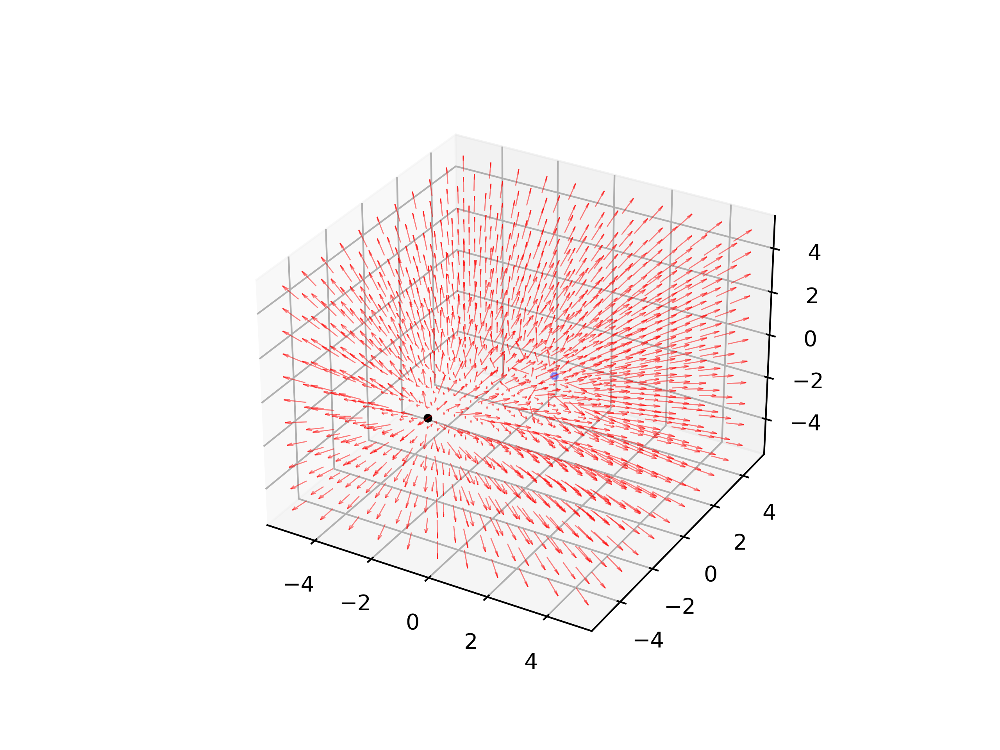

<IPython.core.display.Javascript object>


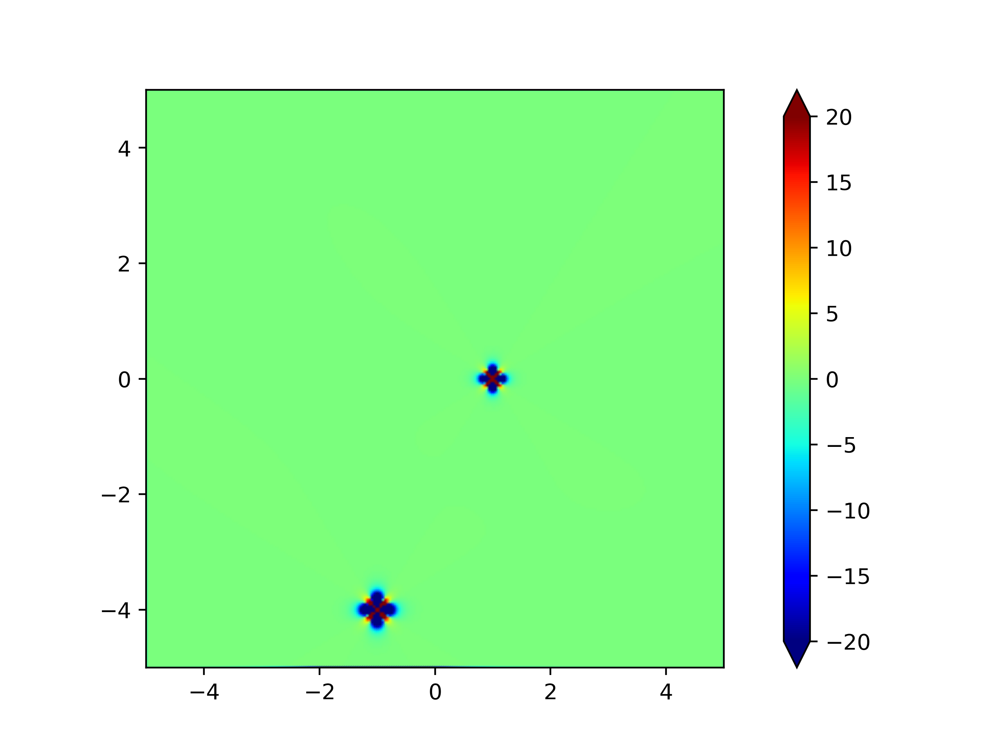

<AxesSubplot:>

In [113]:
# Plot the vector field ...
ax = ed.draw_vector_field(X,Y,Z,*E)

# ... with charges.
ax.scatter3D(*list(zip(R1,R2)),c=['k','b'], s=9)

# Plot the divergence.
ed.draw_scalar_field(X,Y,Z,dE)

Change the charges and their locations, and then recompute the field and its divergence.  Describe your efforts and the results.

The same patterns hold true regardless of charge magnitude or position (for plots with only two point charges) - divergence is highest as you approach the point and goes to zero as you get further away and the field becomes more circular and uniform. 

## Curl

The other combination of derivatives that shows up frequently in physics is called the **curl** of a vector field.  It is another vector field, whose components are particular combinations of derivatives.

$$
\mathbf{curl}(\vec{F}) = \nabla \times \vec{F} =
\left(\dfrac{\partial F_z}{\partial y} - \dfrac{\partial F_y}{\partial z}\right) \, \mathbf{e}_x +
\left(\dfrac{\partial F_x}{\partial z} - \dfrac{\partial F_z}{\partial x}\right) \, \mathbf{e}_y +
\left(\dfrac{\partial F_y}{\partial x} - \dfrac{\partial F_x}{\partial y}\right) \, \mathbf{e}_z
$$

In [114]:
# Define a vector field.
Fx = Y
Fy = -X
Fz = Z**2
F = np.stack([Fx, Fy, Fz])

# Compute the curl.
dF = vc.curl(F,ds)

<IPython.core.display.Javascript object>


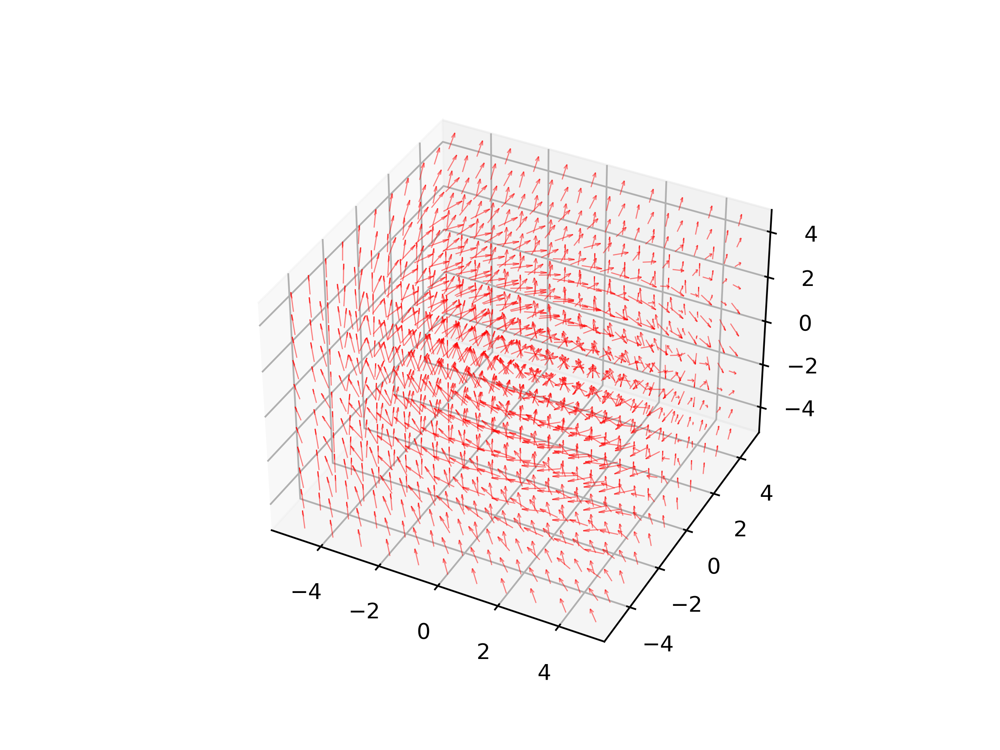

<IPython.core.display.Javascript object>


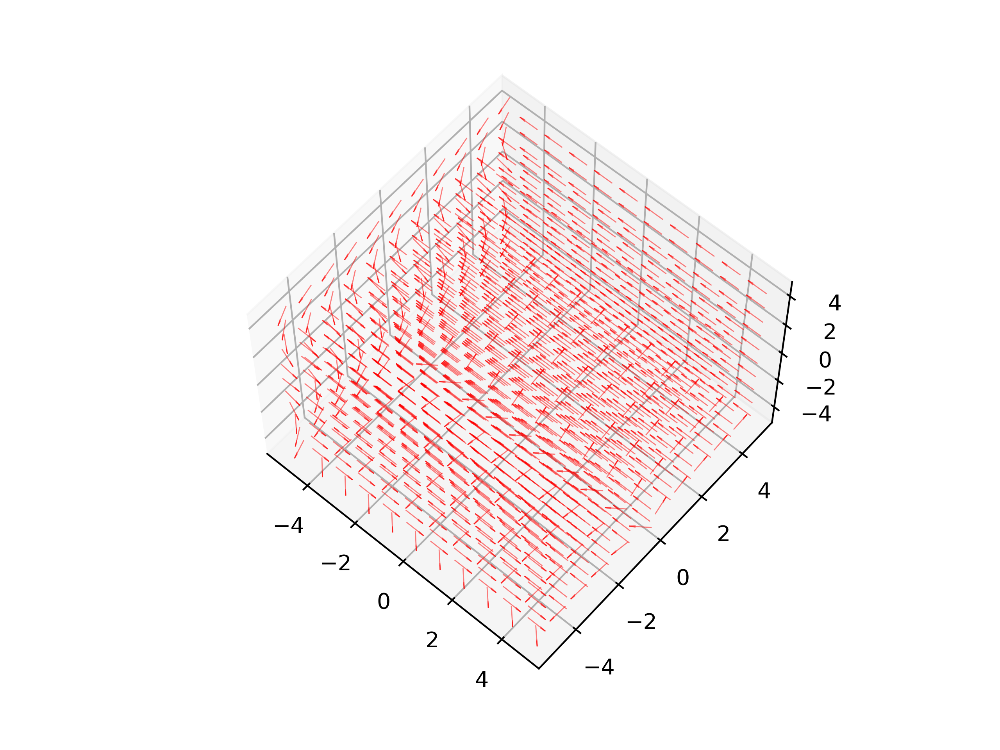

<Axes3DSubplot:>

In [115]:
# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot the curl.
ed.draw_vector_field(X,Y,Z,*dF)

It can be hard to make sense of the mass of arrows, but give it a try.  (You can reduce the number of arrows in a plot using the `stride` keyword ...)

What patterns or correlations do you notice between the arrows in the original vector field and those in its curl?

I twisted both plots to view them from "above" looking down on the x-y plane. In doing so, the first plot showed the vector field that followed a swirling, circular pattern and the plot of the curl seemed to smooth this out into a much more linear criss-cross of fairly straight field lines. These straight-ish lines appear to generally follow the swirling motion exhibited in the vector field, but in a more straighforward path? Almost as if we took derivatives at various points along swirling curve and plotted them?

Try changing the definition of the vector field.  Describe your efforts and observations with other functions.  What was special about the original function?

<IPython.core.display.Javascript object>


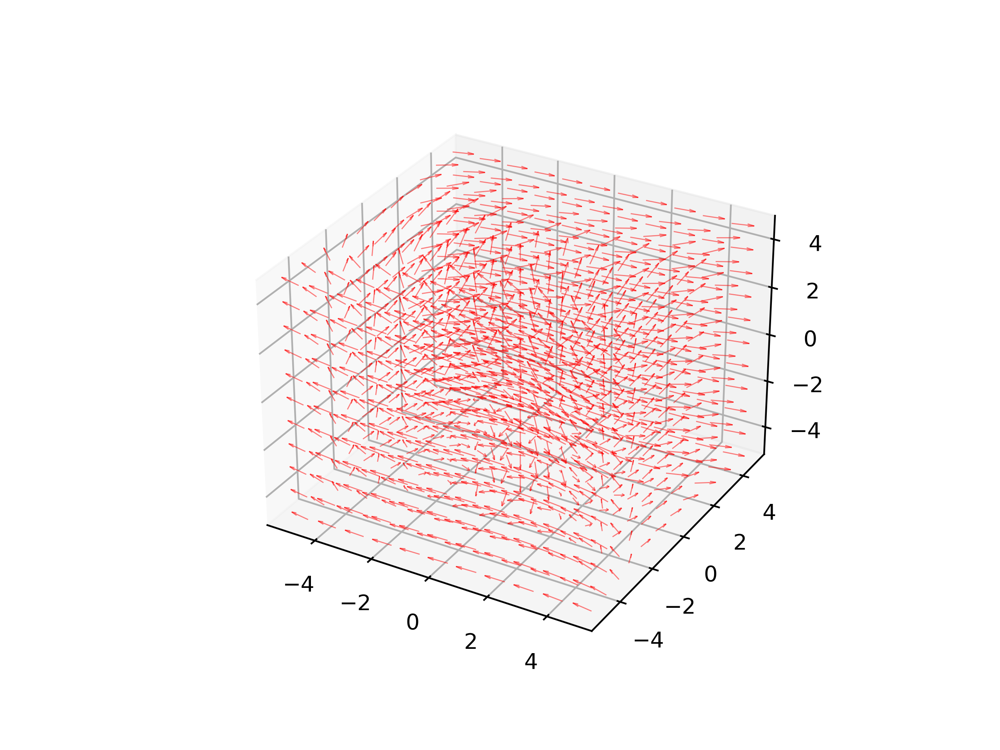

<IPython.core.display.Javascript object>


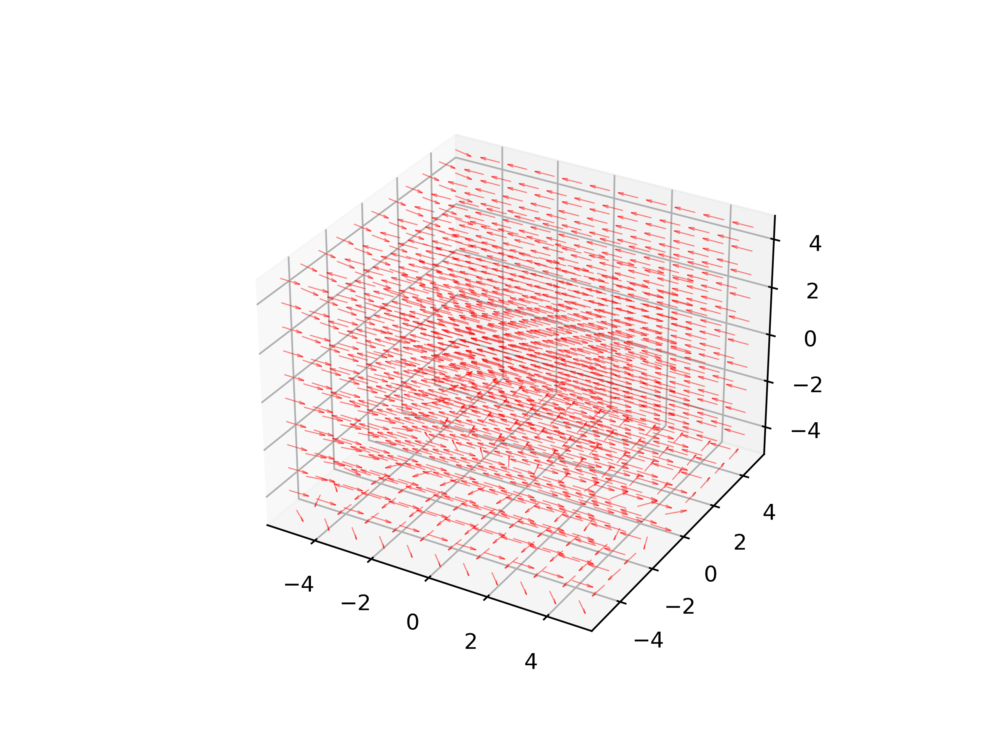

<Axes3DSubplot:>

In [118]:
# Define a vector field.
Fx = Y**3
Fy = X**2
Fz = Z
F = np.stack([Fx, Fy, Fz])

# Compute the curl.
dF = vc.curl(F,ds)

# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot the curl.
ed.draw_vector_field(X,Y,Z,*dF)

The original function produced a circulatory plot, which the plot of the curl attemped to linear-ize. The functions I tested were not as perfectly circulatory but the curl results were similar nonetheless - it appears to generalize the direction of direction of circulation within a particular area. 

## Combinations

Just as we can take second derivatives in calculus, we can combine the vector derivative operations.  Play around with the following.  Change the function definitions, and try to deduce patterns or special cases that seem interesting.

### Divergence of a Gradient

The divergence of the gradient of a function is also called the **laplacian** of the function:
$$\mathbf{div}(\mathbf{grad}(f)) = \nabla \cdot \nabla f = \nabla^2 f$$

In [128]:
## Use this command to turn ON interactive plots:
# %matplotlib notebook

## Use this command to turn OFF interactive plots.
%matplotlib inline

In [129]:
# Define a function in 3D.
f = np.exp(-X**2 - Y - Z**2)

# Compute the divergence of the gradient.
ddf = vc.div(vc.grad(f,ds),ds)

<AxesSubplot:>

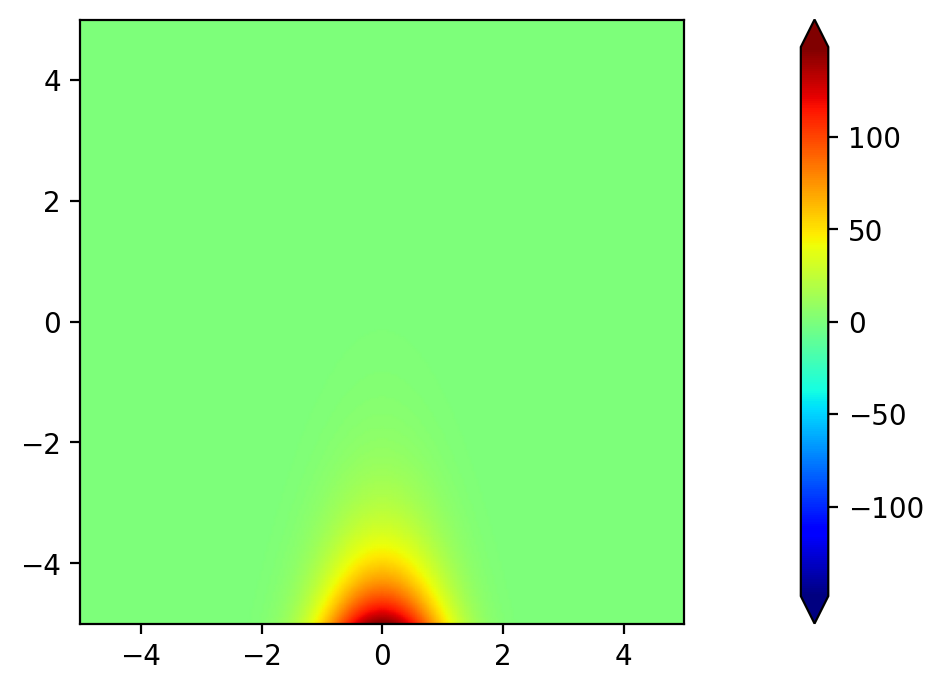

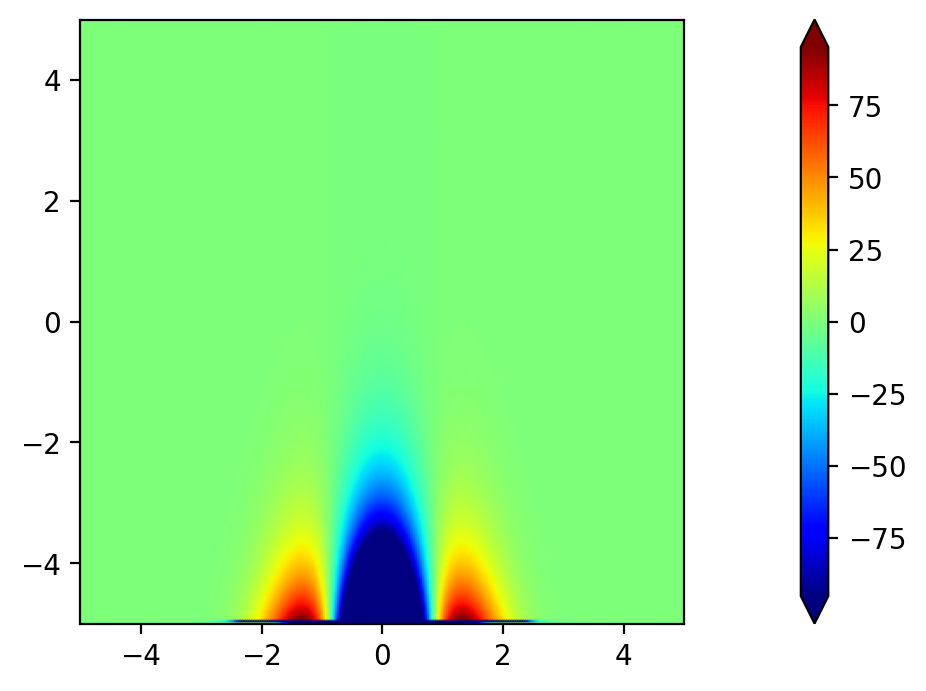

In [130]:
# Draw a slice of the function.
ed.draw_scalar_field(X,Y,Z,f, cutoff=f.max())

# Draw a slice of div-grad-f.
ed.draw_scalar_field(X,Y,Z,ddf, cutoff=ddf.max())

### Curl of a Gradient

The curl of the gradient is defined as
$$\mathbf{curl}(\mathbf{grad}(f)) = \nabla \times \nabla f$$

This operation has no special name.  Can you see why?

In [140]:
# Define a function in 3D.
f = np.exp(-X**2 - Y - Z**2)

# Compute the curl of the gradient.
ddf = vc.curl(vc.grad(f,ds),ds)

<Axes3DSubplot:>

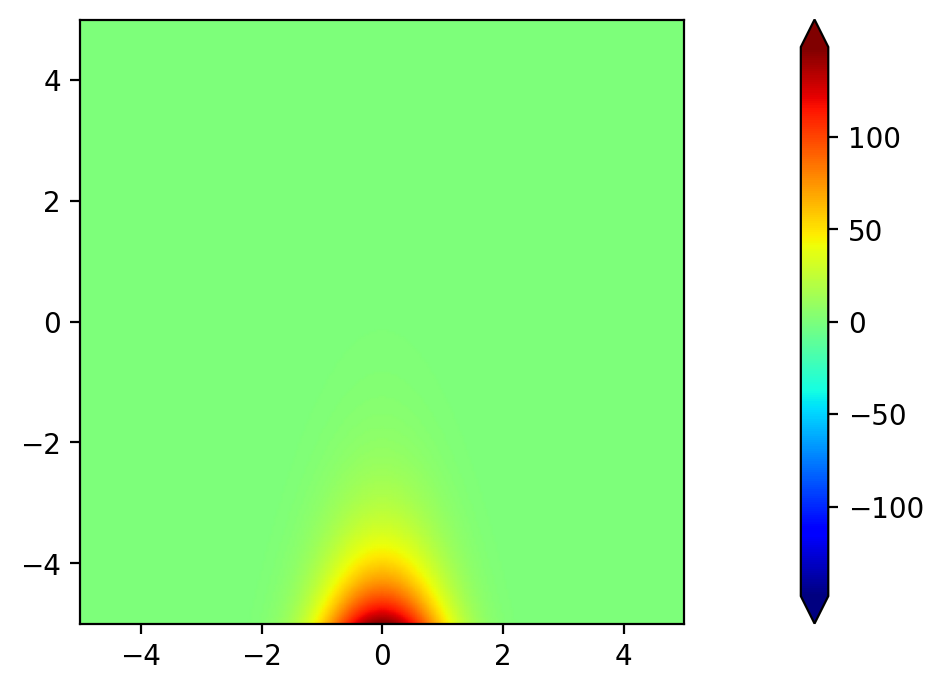

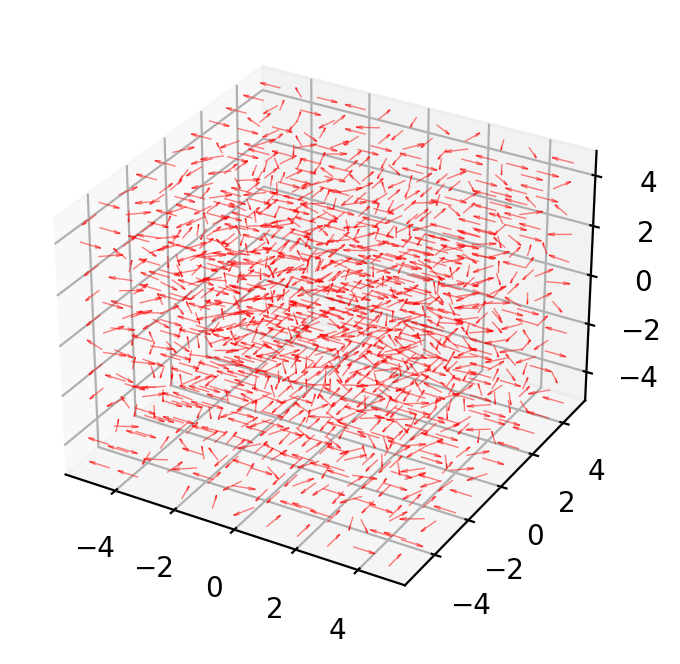

In [141]:
# Draw a slice of the function.
ed.draw_scalar_field(X,Y,Z,f, cutoff=f.max())

# Draw the vector field.
ed.draw_vector_field(X,Y,Z,*ddf)

<AxesSubplot:>

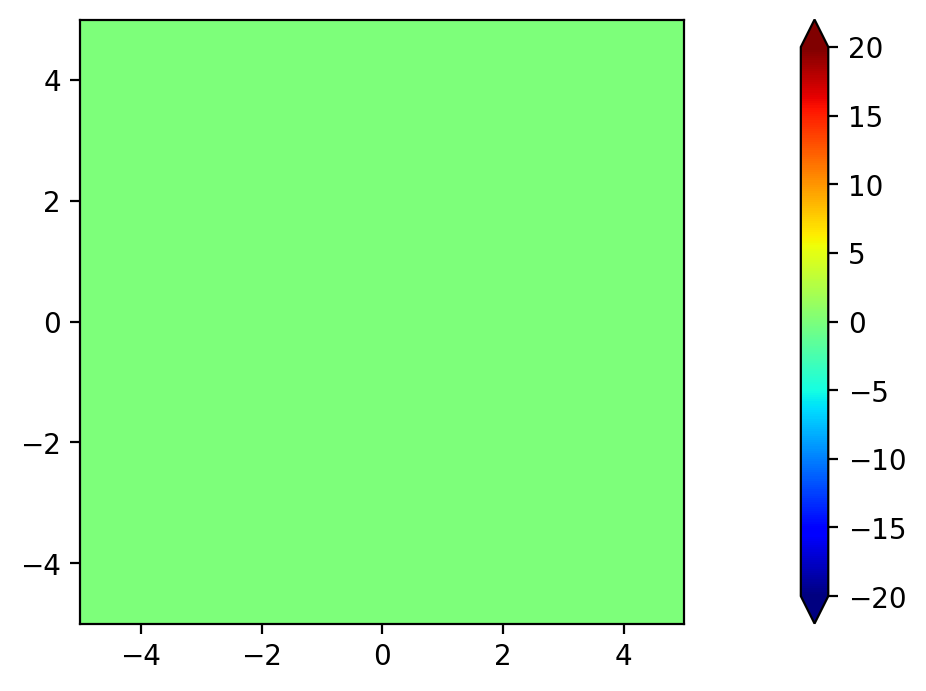

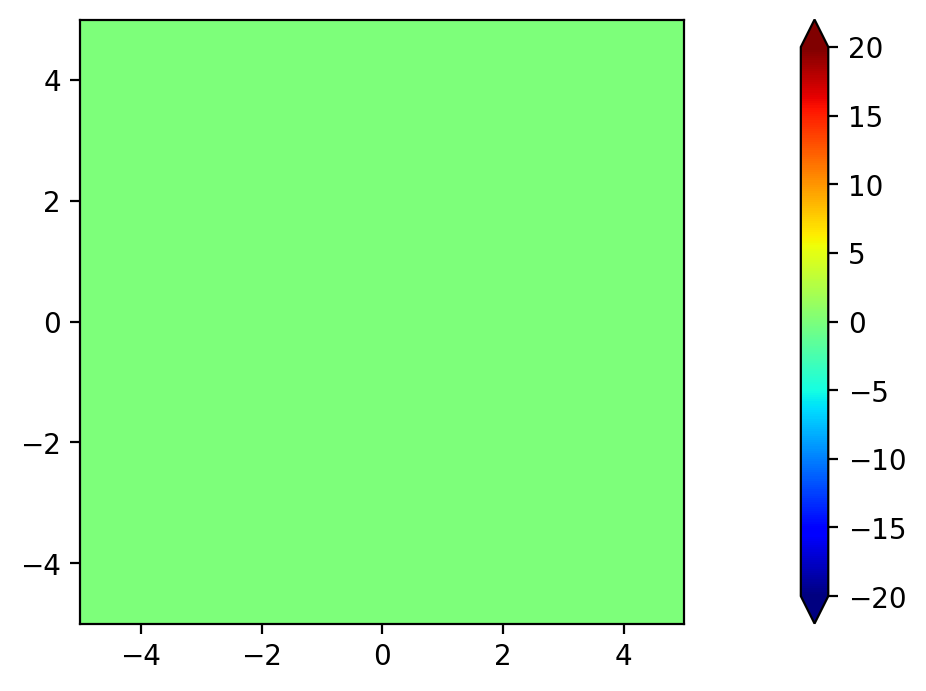

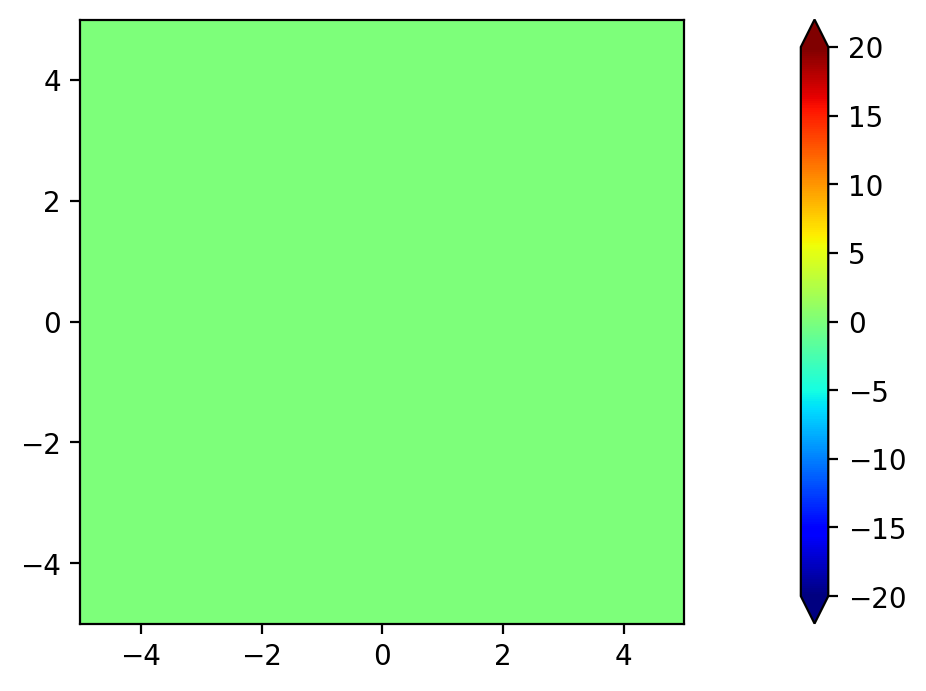

In [144]:
# Draw slices through the components of curl-grad-f.
z0 = 3
ed.draw_scalar_field(X,Y,Z,ddf[0], z0)  # x-component
ed.draw_scalar_field(X,Y,Z,ddf[1], z0)  # y-component
ed.draw_scalar_field(X,Y,Z,ddf[2], z0)  # z-component

### Curl of a Curl

The curl of the curl of a vector field is defined as
$$\mathbf{curl}(\mathbf{curl}(\vec{F})) = \nabla \times (\nabla \times \vec{F})$$

This operation will appear when we look at electromagnetic waves!

In [145]:
# Define a vector field.
Fx = Z*Y**2
Fy = Z*X**2
Fz = X*Y**2
F = np.stack([Fx, Fy, Fz])

# Compute the curl.
ddF = vc.curl(vc.curl(F,ds),ds)

<Axes3DSubplot:>

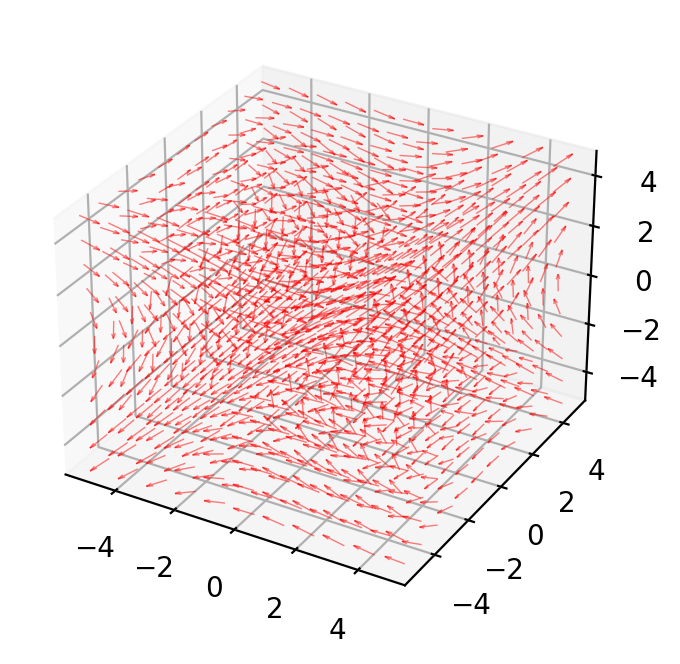

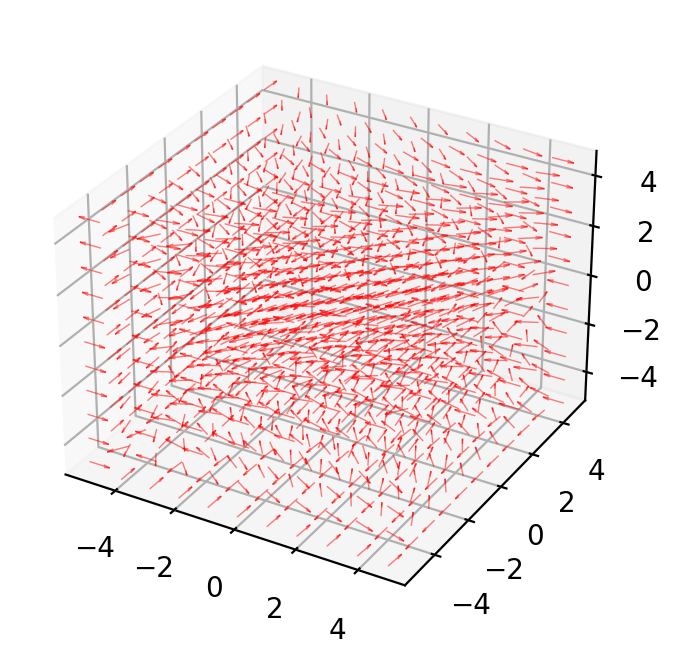

In [146]:
# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot the curl-of-the-curl.
ed.draw_vector_field(X,Y,Z,*ddF)

<AxesSubplot:>

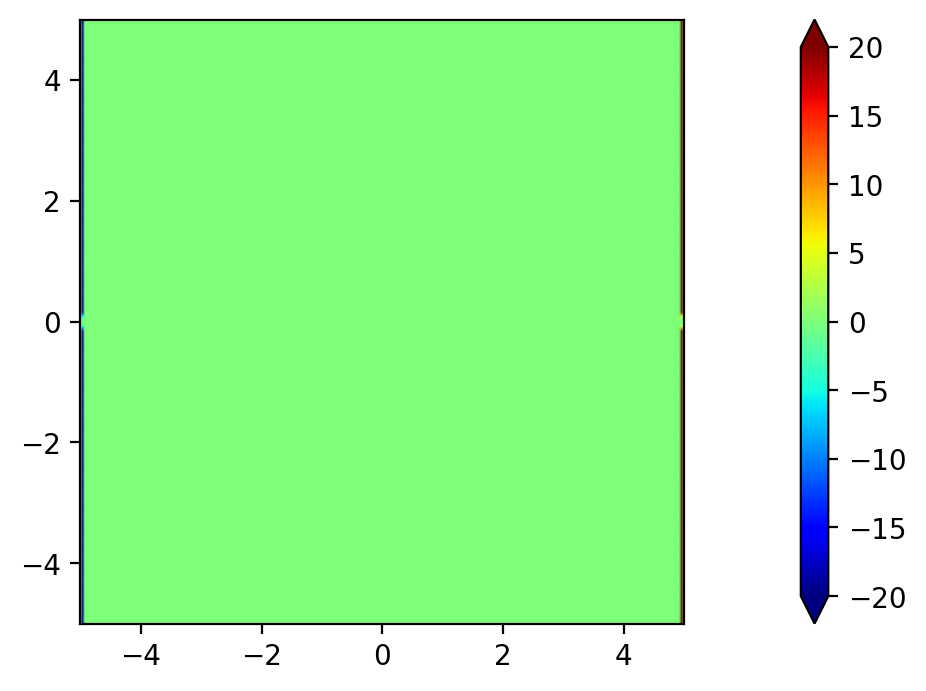

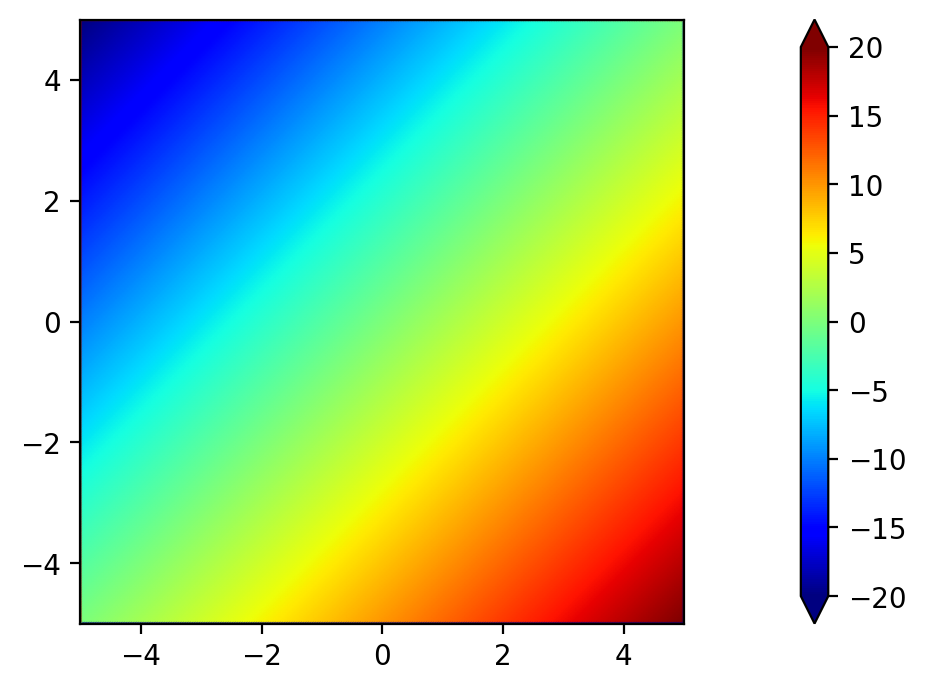

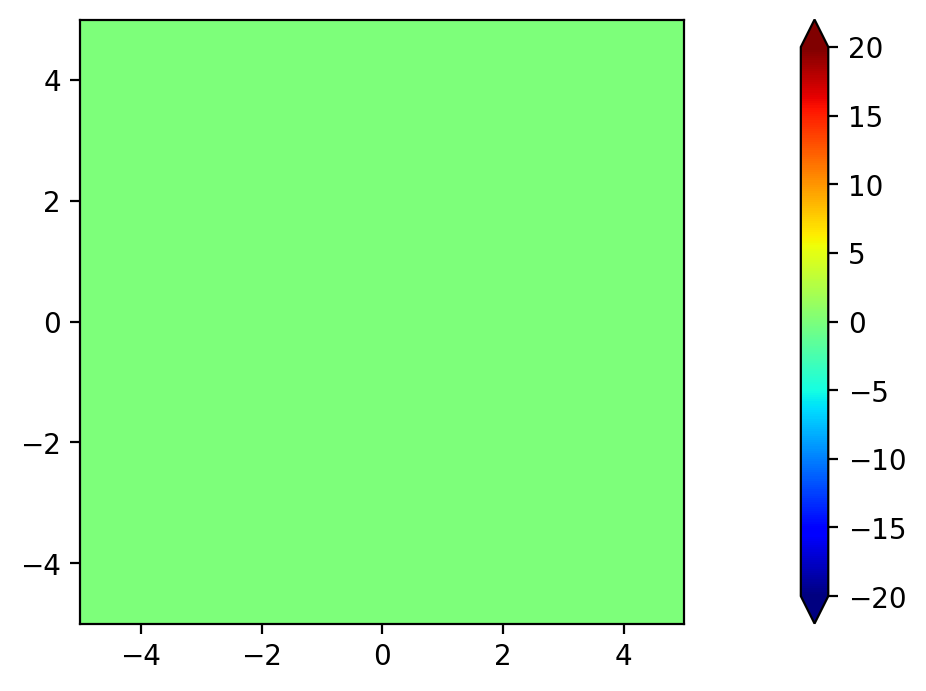

In [148]:
# Draw slices through the components of curl-curl-f.
z0 = 0.0
ed.draw_scalar_field(X,Y,Z,ddF[0], z0)  # x-component
ed.draw_scalar_field(X,Y,Z,ddF[1], z0)  # y-component
ed.draw_scalar_field(X,Y,Z,ddF[2], z0)  # z-component

### Divergence of a Curl

The divergence of the curl is written as
$$\mathbf{div}(\mathbf{curl}(\vec{F})) = \nabla \cdot (\nabla \times \vec{F})$$

This one has no special name either ...

In [149]:
# Define a vector field.
Fx = Z*Y**2
Fy = Z*X**2
Fz = X*Y**2
F = np.stack([Fx, Fy, Fz])

# Compute the curl.
ddF = vc.div(vc.curl(F,ds),ds)

<AxesSubplot:>

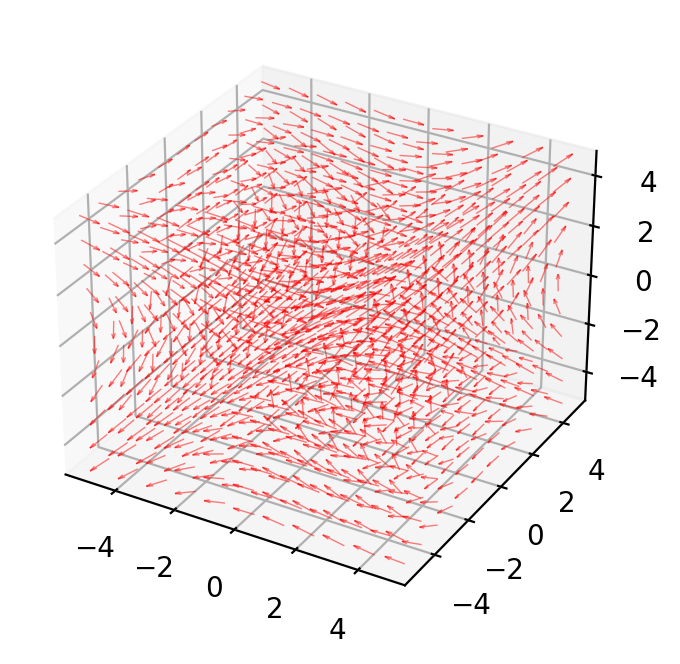

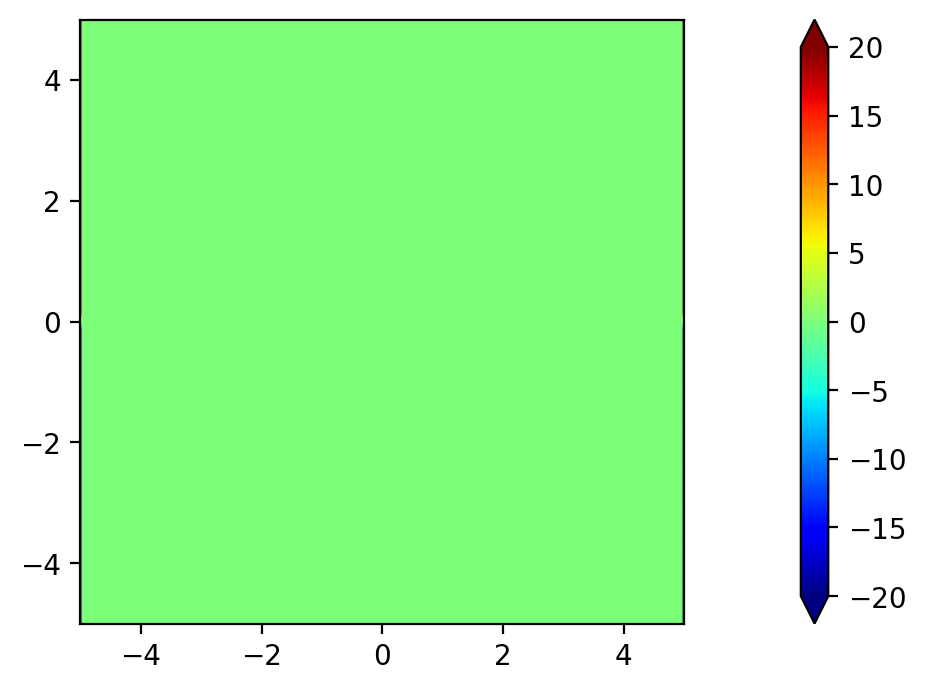

In [150]:
# Plot the vector field.
ed.draw_vector_field(X,Y,Z,*F)

# Plot a slice of div-curl-F.
z0 = 0.0
ed.draw_scalar_field(X,Y,Z,ddF, z0)

## Reflection and Summary

Congratulations!  You just completed a crash course in vector calculus!

- What are the major takeaways of this assignment for you?
- What was the most difficult part of this assignment?
- What was the most interesting part of this assignment?
- What questions do you have?

This assignment was really helpful for me to visualize the concepts of gradients and curls, both in 2D and 3D. The interactive plots were especially helpful and were also the part I found most interesting. I felt like I understood gradients fairly well when I took vector calculus a few years ago, but I never fully grasped the concept until now. I'm still a bit fuzzy on curls but I have a feeling we'll cover that more in the next class.

The most challenging part was finding new ways to use the existing code. I'm still struggling a bit to pick up Python. I found your #comments helpful, especially the ones that describe exactly WHAT the function is doing, WHAT the inputs to the function are and WHY we're using it in the first place. 

I don't have any specific questions at this point. I think an in-class walkthrough of the "curl" concept would be great, as would a code walkthrough where Dr. Kinder explains how he designed the Python script to solve these problems. 